Copyright (c) 2020 Ryan Cohn and Elizabeth Holm. All rights reserved. <br />
Licensed under the MIT License (see LICENSE for details) <br />
Written by Ryan Cohn

# Instance Segmentation of Powder Particles and Satellites

This example will take you through the process of training a model to segment powder particles and visualizing the model predictions.

In [2]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

root = '../'
sys.path.append(root)

from sat_helpers import data_utils, visualize, export_anno

%matplotlib inline

# Labeling Data

The [VGG Image Annotator](http://www.robots.ox.ac.uk/~vgg/software/via/) was used to generate particle labels. The a

# Loading Data
The process for training models for powder particles and satellites is identical. Enter the corresponding value depending on which model you want to train. <br />
The paths to individual images, and all annotation data are stored in the JSON files generated by the VGG image annotator.



In [3]:
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path(root, 'data', 'VIA', 'satellite_training.json')  # path to training data
json_path_val = Path(root, 'data', 'VIA', 'satellite_validation.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'


## Registration
Detectron2 requires that datasets be registered for later use.
Registration stores the name of the dataset and a function that can be used to retrieve the image paths and labels in a format that the model can use.

In [4]:
DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')

## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


## Verify images and annotations are loaded correctly
Also, this is a great time to admire my hand-drawn labels, which took sooooo long to do!
### Training Data

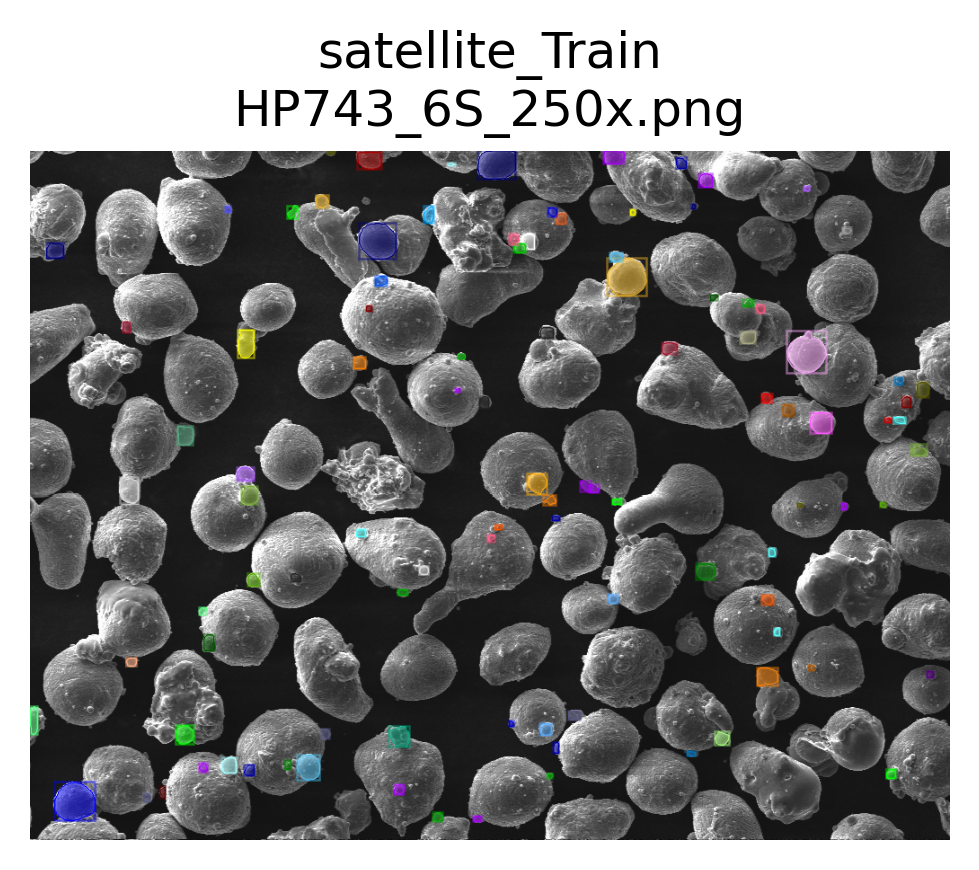

ddict info:
	path: ../data/VIA/../SEM/HP743_6S_250x.png
	num_instances: 102


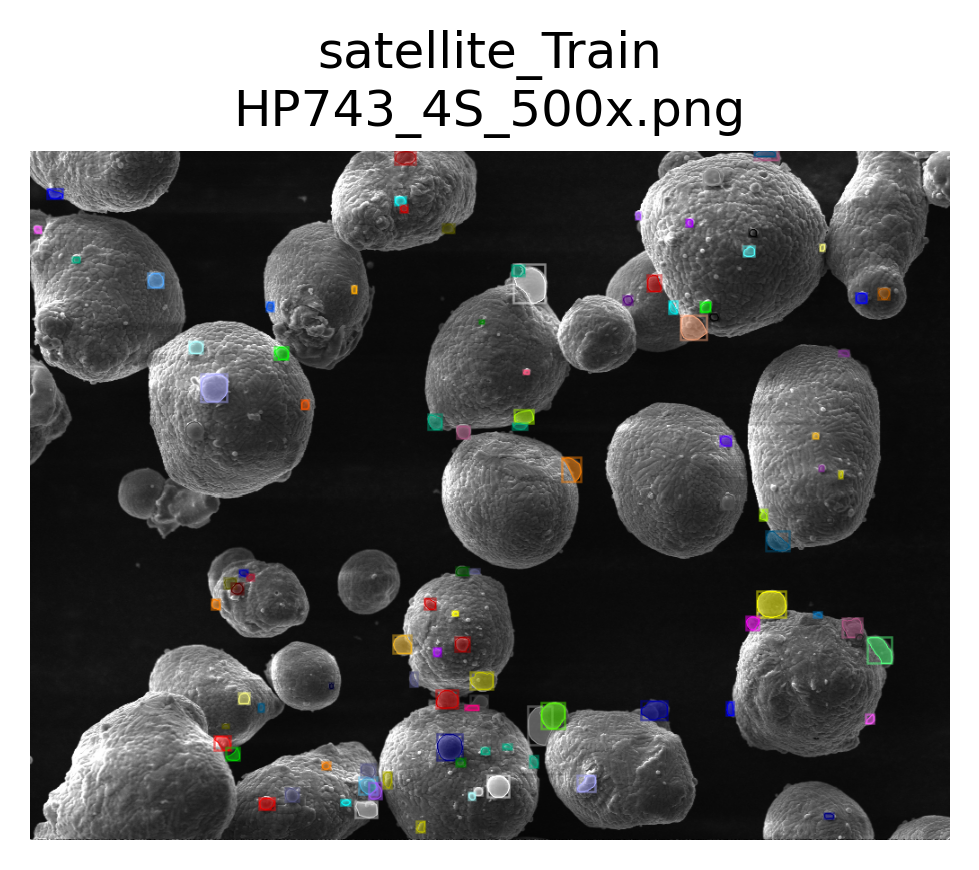

ddict info:
	path: ../data/VIA/../SEM/HP743_4S_500x.png
	num_instances: 103


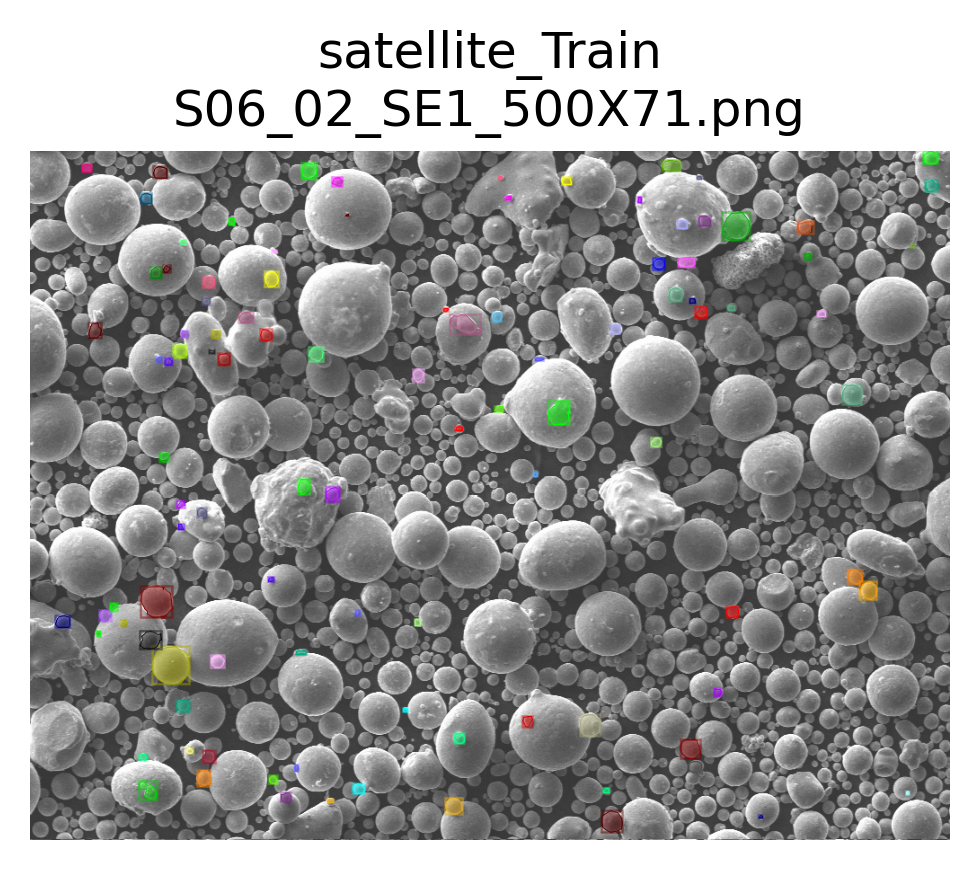

ddict info:
	path: ../data/VIA/../SEM/S06_02_SE1_500X71.png
	num_instances: 104


In [5]:
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)
#To view annotations on the entire dataset and not just 3 random instances, uncomment the following code
#for i in DatasetCatalog.get(dataset_train):
    #visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

### Validation Data

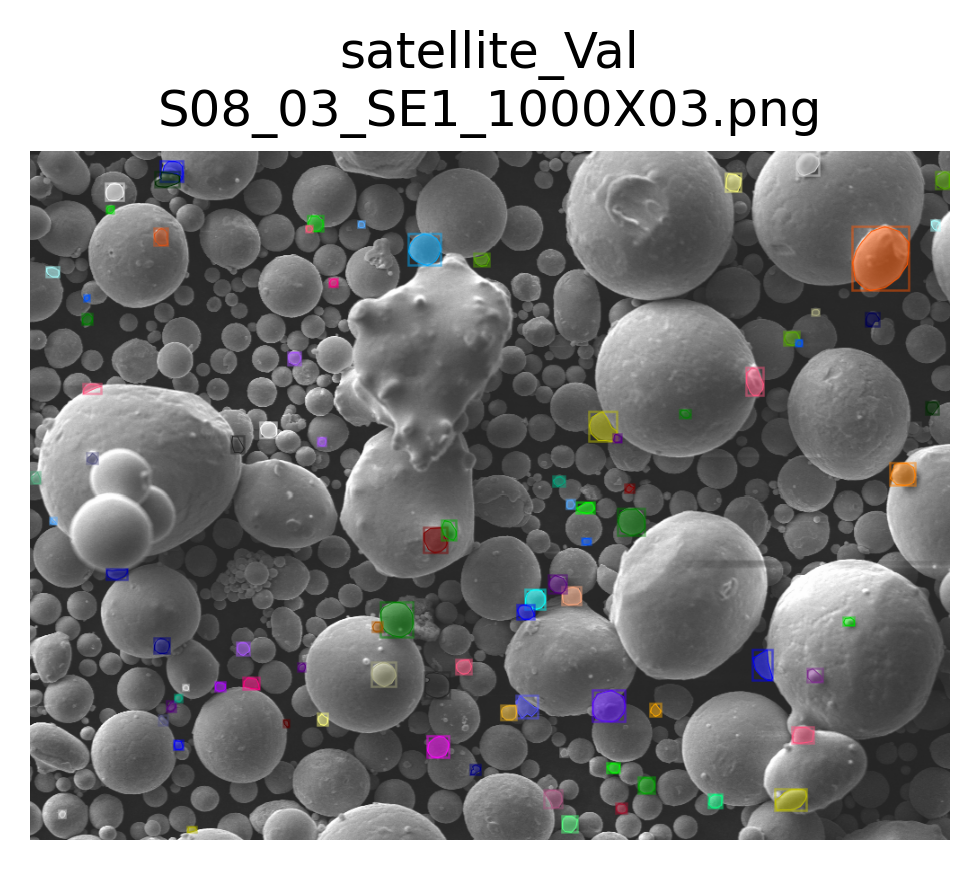

ddict info:
	path: ../data/VIA/../SEM/S08_03_SE1_1000X03.png
	num_instances: 88


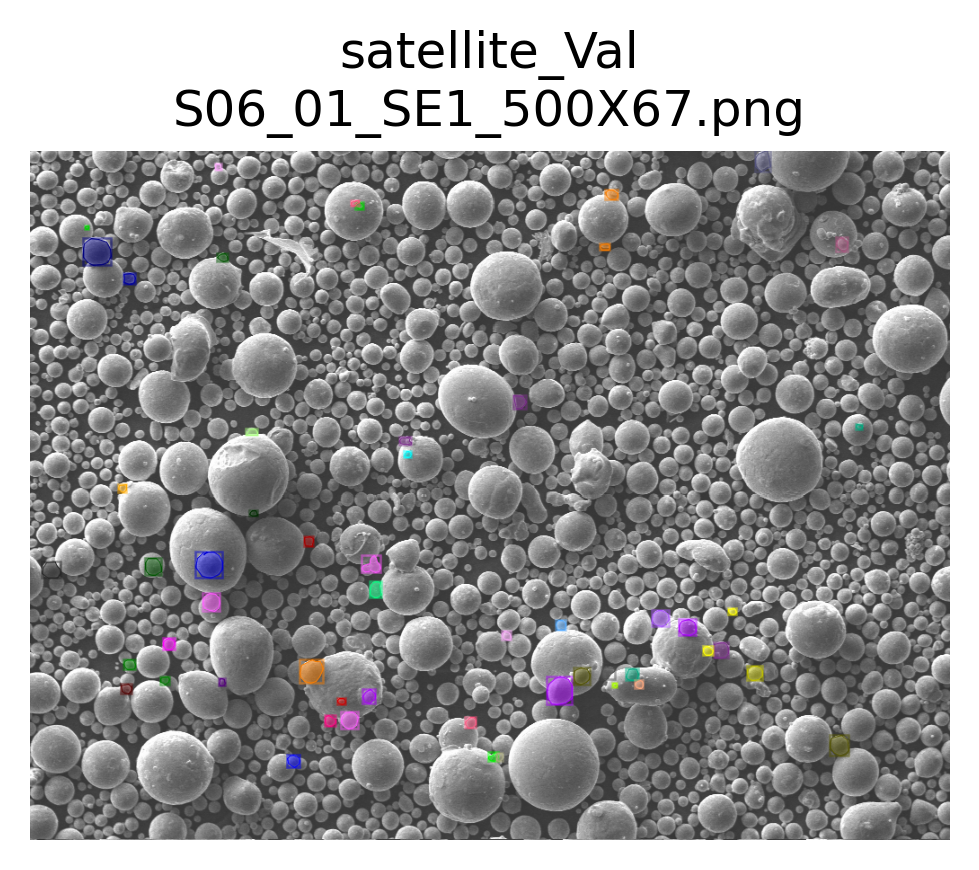

ddict info:
	path: ../data/VIA/../SEM/S06_01_SE1_500X67.png
	num_instances: 54


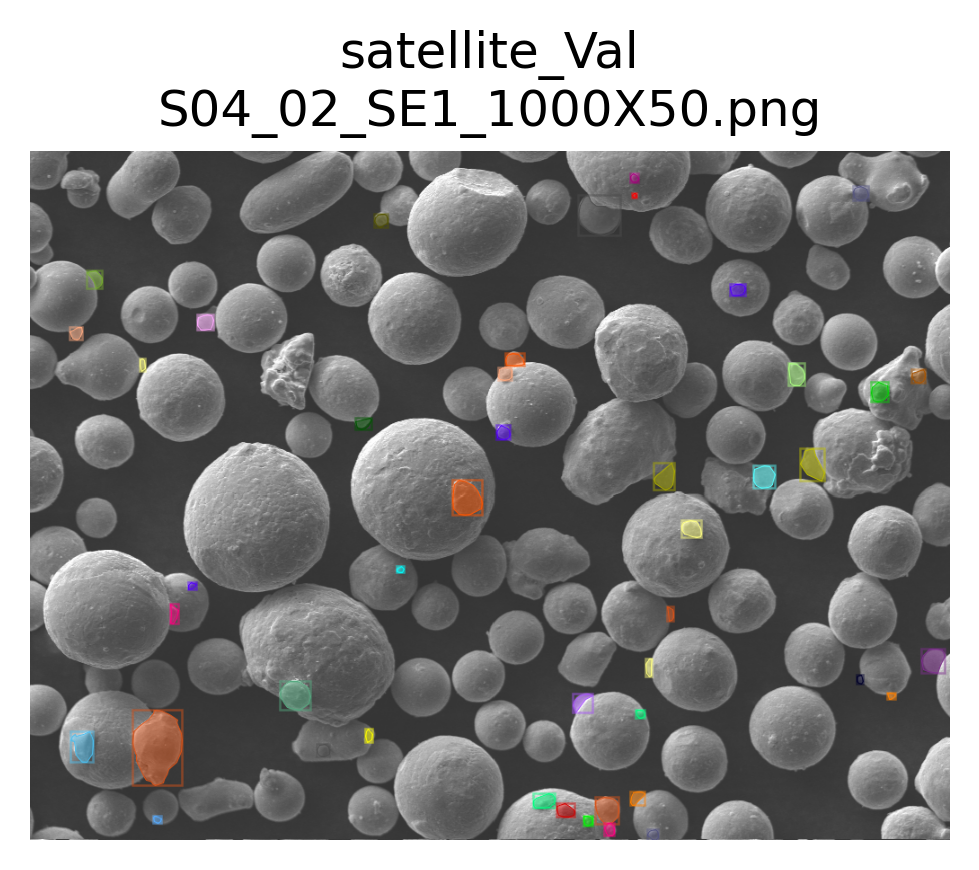

ddict info:
	path: ../data/VIA/../SEM/S04_02_SE1_1000X50.png
	num_instances: 45


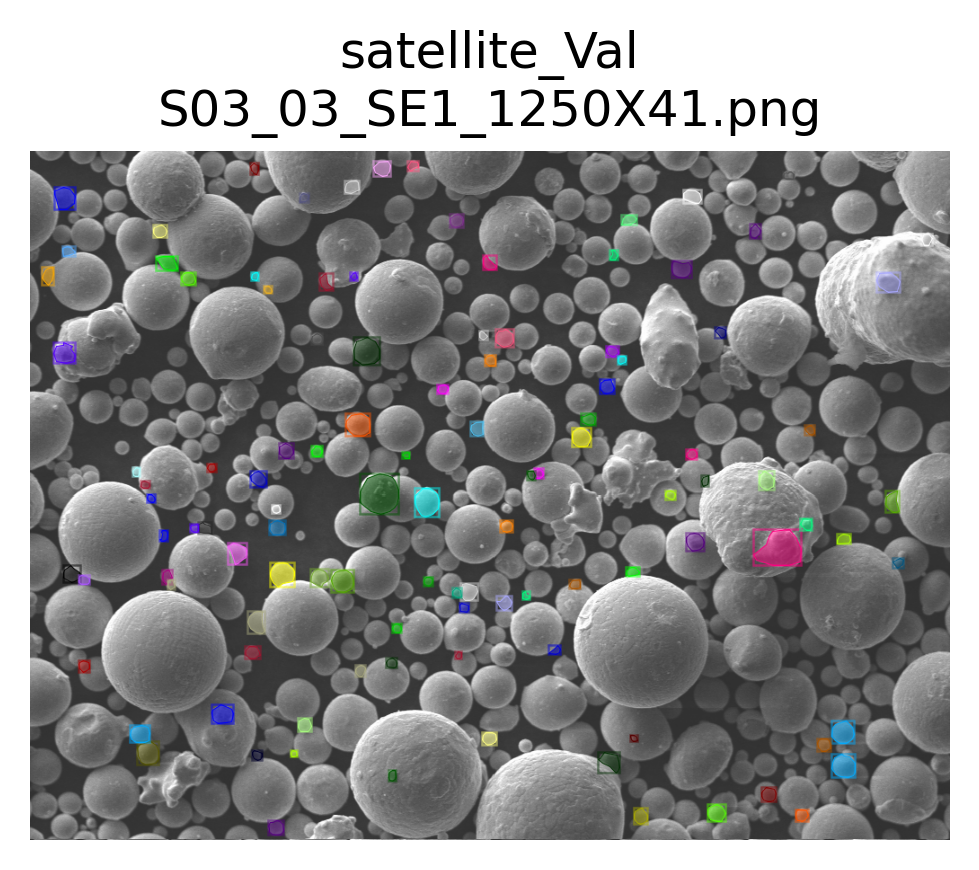

ddict info:
	path: ../data/VIA/../SEM/S03_03_SE1_1250X41.png
	num_instances: 111


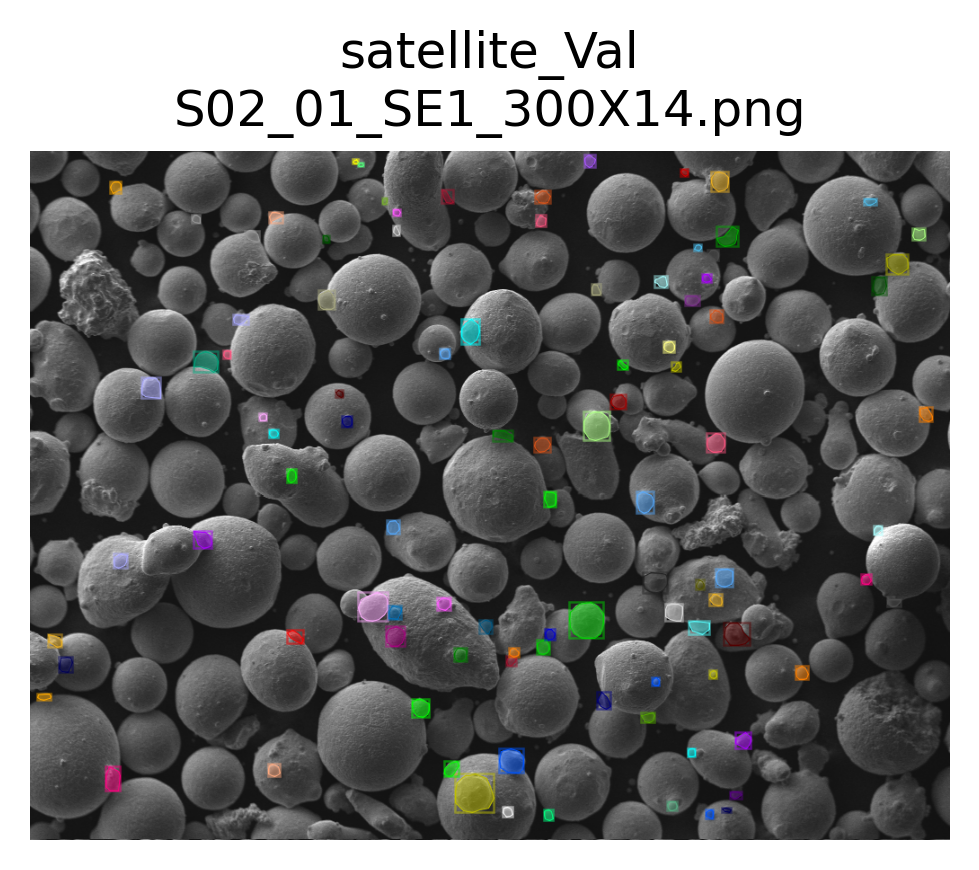

ddict info:
	path: ../data/VIA/../SEM/S02_01_SE1_300X14.png
	num_instances: 98


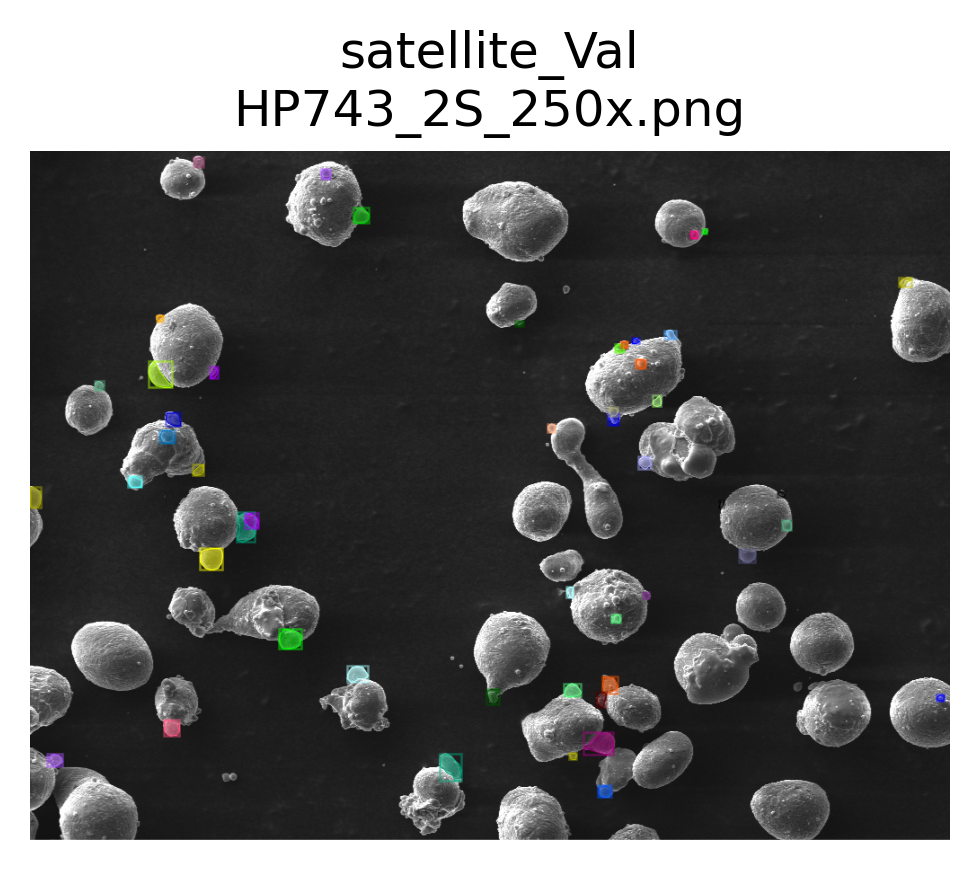

ddict info:
	path: ../data/VIA/../SEM/HP743_2S_250x.png
	num_instances: 49


In [6]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [7]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 1000  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = 5000  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH = 0.5
# model weights will be downloaded if they are not present
weights_path = Path('..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path(root,'Models', 'SALAS_model-1'))
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


# Model Training
Once we have everything set up, training is very easy!

Note- this block will generate a huge wall of text.

In [8]:
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[08/09 15:21:37 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[08/09 15:21:38 d2.data.build]: Removed 0 images with no usable annotations. 20 images left.
[08/09 15:21:38 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
| satellite  | 1412         |
|            |              |
[08/09 15:21:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[08/09 15:21:38 d2.data.build]: Using training sampler TrainingSampler
[08/09 15:21:38 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[08/09 15:21:38 d2.data.common]: Serialized dataset takes 0.46 MiB
WARNING [08/09 15:21:38 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.


/jet/home/sprice/.local/lib/python3.8/site-packages/torch/utils/data/dataloader.py:474: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 1, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[08/09 15:21:38 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[08/09 15:21:38 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint      | Shapes                                          |
|:------------------|:-------------------------|:------------------------------------------------|
| res2.0.conv1.*    | res2_0_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| res2.0.conv2.*    | res2_0_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.0.conv3.*    | res2_0_branch2c_{bn_*,w} | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.0.shortcut.* | res2_0_branch1_{bn_*,w}  | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.1.conv1.*    | res2_1_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,256,1,1)            |
| res2.1.conv2.*    | res2_1_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.1.conv3.*  

[08/09 15:22:12 d2.utils.events]:  eta: 0:11:19  iter: 219  total_loss: 1.767  loss_cls: 0.2461  loss_box_reg: 0.4305  loss_mask: 0.3435  loss_rpn_cls: 0.2737  loss_rpn_loc: 0.4663  time: 0.1420  data_time: 0.0156  lr: 0.0043956  max_mem: 1823M
[08/09 15:22:15 d2.utils.events]:  eta: 0:11:16  iter: 239  total_loss: 1.638  loss_cls: 0.2215  loss_box_reg: 0.3828  loss_mask: 0.3235  loss_rpn_cls: 0.2228  loss_rpn_loc: 0.4411  time: 0.1423  data_time: 0.0150  lr: 0.0047952  max_mem: 1823M
[08/09 15:22:18 d2.utils.events]:  eta: 0:11:14  iter: 259  total_loss: 1.745  loss_cls: 0.2835  loss_box_reg: 0.4392  loss_mask: 0.3231  loss_rpn_cls: 0.2537  loss_rpn_loc: 0.4418  time: 0.1426  data_time: 0.0156  lr: 0.0051948  max_mem: 1823M
[08/09 15:22:20 d2.utils.events]:  eta: 0:11:11  iter: 279  total_loss: 1.827  loss_cls: 0.2817  loss_box_reg: 0.4949  loss_mask: 0.3261  loss_rpn_cls: 0.2483  loss_rpn_loc: 0.4465  time: 0.1426  data_time: 0.0146  lr: 0.0055944  max_mem: 1823M
[08/09 15:22:23 d2.u

[08/09 15:23:50 d2.utils.events]:  eta: 0:10:01  iter: 879  total_loss: 1.465  loss_cls: 0.189  loss_box_reg: 0.2798  loss_mask: 0.2373  loss_rpn_cls: 0.2505  loss_rpn_loc: 0.487  time: 0.1464  data_time: 0.0149  lr: 0.017582  max_mem: 1823M
[08/09 15:23:53 d2.utils.events]:  eta: 0:09:57  iter: 899  total_loss: 1.551  loss_cls: 0.1653  loss_box_reg: 0.3046  loss_mask: 0.2564  loss_rpn_cls: 0.2512  loss_rpn_loc: 0.5315  time: 0.1463  data_time: 0.0166  lr: 0.017982  max_mem: 1823M
[08/09 15:23:55 d2.utils.events]:  eta: 0:09:55  iter: 919  total_loss: 1.507  loss_cls: 0.2047  loss_box_reg: 0.3554  loss_mask: 0.2444  loss_rpn_cls: 0.1961  loss_rpn_loc: 0.4547  time: 0.1463  data_time: 0.0143  lr: 0.018382  max_mem: 1823M
[08/09 15:23:58 d2.utils.events]:  eta: 0:09:52  iter: 939  total_loss: 1.431  loss_cls: 0.1992  loss_box_reg: 0.371  loss_mask: 0.2414  loss_rpn_cls: 0.1726  loss_rpn_loc: 0.479  time: 0.1463  data_time: 0.0149  lr: 0.018781  max_mem: 1823M
[08/09 15:24:01 d2.utils.eve

[08/09 15:25:28 d2.utils.events]:  eta: 0:08:28  iter: 1539  total_loss: 1.417  loss_cls: 0.1952  loss_box_reg: 0.4456  loss_mask: 0.2054  loss_rpn_cls: 0.1677  loss_rpn_loc: 0.3895  time: 0.1466  data_time: 0.0147  lr: 0.02  max_mem: 1823M
[08/09 15:25:31 d2.utils.events]:  eta: 0:08:25  iter: 1559  total_loss: 1.3  loss_cls: 0.2099  loss_box_reg: 0.4256  loss_mask: 0.1969  loss_rpn_cls: 0.1338  loss_rpn_loc: 0.3522  time: 0.1466  data_time: 0.0135  lr: 0.02  max_mem: 1823M
[08/09 15:25:34 d2.utils.events]:  eta: 0:08:22  iter: 1579  total_loss: 1.395  loss_cls: 0.2139  loss_box_reg: 0.4119  loss_mask: 0.1991  loss_rpn_cls: 0.1778  loss_rpn_loc: 0.3658  time: 0.1466  data_time: 0.0148  lr: 0.02  max_mem: 1823M
[08/09 15:25:37 d2.utils.events]:  eta: 0:08:19  iter: 1599  total_loss: 1.402  loss_cls: 0.2226  loss_box_reg: 0.432  loss_mask: 0.1972  loss_rpn_cls: 0.1451  loss_rpn_loc: 0.3573  time: 0.1466  data_time: 0.0138  lr: 0.02  max_mem: 1823M
[08/09 15:25:40 d2.utils.events]:  eta:

[08/09 15:27:07 d2.utils.events]:  eta: 0:06:53  iter: 2199  total_loss: 1.266  loss_cls: 0.197  loss_box_reg: 0.4044  loss_mask: 0.1911  loss_rpn_cls: 0.1648  loss_rpn_loc: 0.3414  time: 0.1471  data_time: 0.0151  lr: 0.02  max_mem: 1823M
[08/09 15:27:09 d2.utils.events]:  eta: 0:06:50  iter: 2219  total_loss: 1.213  loss_cls: 0.201  loss_box_reg: 0.3884  loss_mask: 0.1953  loss_rpn_cls: 0.1265  loss_rpn_loc: 0.3432  time: 0.1470  data_time: 0.0149  lr: 0.02  max_mem: 1823M
[08/09 15:27:12 d2.utils.events]:  eta: 0:06:47  iter: 2239  total_loss: 1.178  loss_cls: 0.1916  loss_box_reg: 0.3663  loss_mask: 0.1844  loss_rpn_cls: 0.1298  loss_rpn_loc: 0.342  time: 0.1471  data_time: 0.0150  lr: 0.02  max_mem: 1823M
[08/09 15:27:15 d2.utils.events]:  eta: 0:06:44  iter: 2259  total_loss: 1.262  loss_cls: 0.1758  loss_box_reg: 0.3446  loss_mask: 0.1861  loss_rpn_cls: 0.1345  loss_rpn_loc: 0.3953  time: 0.1471  data_time: 0.0146  lr: 0.02  max_mem: 1823M
[08/09 15:27:19 d2.utils.events]:  eta:

[08/09 15:28:46 d2.utils.events]:  eta: 0:05:18  iter: 2859  total_loss: 1.161  loss_cls: 0.1654  loss_box_reg: 0.3545  loss_mask: 0.1586  loss_rpn_cls: 0.1413  loss_rpn_loc: 0.3294  time: 0.1476  data_time: 0.0157  lr: 0.02  max_mem: 1823M
[08/09 15:28:49 d2.utils.events]:  eta: 0:05:15  iter: 2879  total_loss: 1.129  loss_cls: 0.1717  loss_box_reg: 0.3482  loss_mask: 0.1785  loss_rpn_cls: 0.094  loss_rpn_loc: 0.323  time: 0.1476  data_time: 0.0148  lr: 0.02  max_mem: 1823M
[08/09 15:28:52 d2.utils.events]:  eta: 0:05:12  iter: 2899  total_loss: 1.122  loss_cls: 0.1641  loss_box_reg: 0.3535  loss_mask: 0.1627  loss_rpn_cls: 0.1103  loss_rpn_loc: 0.3127  time: 0.1476  data_time: 0.0155  lr: 0.02  max_mem: 1823M
[08/09 15:28:55 d2.utils.events]:  eta: 0:05:09  iter: 2919  total_loss: 1.122  loss_cls: 0.1839  loss_box_reg: 0.3791  loss_mask: 0.1771  loss_rpn_cls: 0.09981  loss_rpn_loc: 0.2988  time: 0.1476  data_time: 0.0147  lr: 0.02  max_mem: 1823M
[08/09 15:28:58 d2.utils.events]:  et

[08/09 15:30:31 d2.utils.events]:  eta: 0:03:42  iter: 3519  total_loss: 1.112  loss_cls: 0.1789  loss_box_reg: 0.3547  loss_mask: 0.1673  loss_rpn_cls: 0.07552  loss_rpn_loc: 0.3087  time: 0.1496  data_time: 0.0216  lr: 0.02  max_mem: 1823M
[08/09 15:30:35 d2.utils.events]:  eta: 0:03:39  iter: 3539  total_loss: 1.139  loss_cls: 0.1836  loss_box_reg: 0.3516  loss_mask: 0.1722  loss_rpn_cls: 0.09909  loss_rpn_loc: 0.2888  time: 0.1498  data_time: 0.0192  lr: 0.02  max_mem: 1823M
[08/09 15:30:38 d2.utils.events]:  eta: 0:03:36  iter: 3559  total_loss: 1.094  loss_cls: 0.1586  loss_box_reg: 0.355  loss_mask: 0.1673  loss_rpn_cls: 0.09918  loss_rpn_loc: 0.3115  time: 0.1498  data_time: 0.0152  lr: 0.02  max_mem: 1823M
[08/09 15:30:41 d2.utils.events]:  eta: 0:03:33  iter: 3579  total_loss: 1.12  loss_cls: 0.1541  loss_box_reg: 0.3686  loss_mask: 0.1825  loss_rpn_cls: 0.09195  loss_rpn_loc: 0.3081  time: 0.1498  data_time: 0.0153  lr: 0.02  max_mem: 1823M
[08/09 15:30:44 d2.utils.events]: 

[08/09 15:32:29 d2.utils.events]:  eta: 0:02:08  iter: 4179  total_loss: 0.9964  loss_cls: 0.151  loss_box_reg: 0.3236  loss_mask: 0.1484  loss_rpn_cls: 0.09872  loss_rpn_loc: 0.292  time: 0.1537  data_time: 0.0186  lr: 0.02  max_mem: 1823M
[08/09 15:32:33 d2.utils.events]:  eta: 0:02:06  iter: 4199  total_loss: 0.9956  loss_cls: 0.1434  loss_box_reg: 0.3311  loss_mask: 0.1542  loss_rpn_cls: 0.08385  loss_rpn_loc: 0.2642  time: 0.1540  data_time: 0.0185  lr: 0.02  max_mem: 1823M
[08/09 15:32:38 d2.utils.events]:  eta: 0:02:03  iter: 4219  total_loss: 0.9802  loss_cls: 0.1479  loss_box_reg: 0.3177  loss_mask: 0.1576  loss_rpn_cls: 0.09417  loss_rpn_loc: 0.2938  time: 0.1543  data_time: 0.0215  lr: 0.02  max_mem: 1823M
[08/09 15:32:42 d2.utils.events]:  eta: 0:02:01  iter: 4239  total_loss: 0.9816  loss_cls: 0.1481  loss_box_reg: 0.3354  loss_mask: 0.1653  loss_rpn_cls: 0.07045  loss_rpn_loc: 0.2688  time: 0.1545  data_time: 0.0169  lr: 0.02  max_mem: 1823M
[08/09 15:32:46 d2.utils.event

[08/09 15:34:18 d2.utils.events]:  eta: 0:00:25  iter: 4839  total_loss: 0.9722  loss_cls: 0.1305  loss_box_reg: 0.3267  loss_mask: 0.1537  loss_rpn_cls: 0.07573  loss_rpn_loc: 0.2789  time: 0.1552  data_time: 0.0155  lr: 0.02  max_mem: 1823M
[08/09 15:34:21 d2.utils.events]:  eta: 0:00:21  iter: 4859  total_loss: 0.9408  loss_cls: 0.134  loss_box_reg: 0.3074  loss_mask: 0.1419  loss_rpn_cls: 0.08268  loss_rpn_loc: 0.2712  time: 0.1552  data_time: 0.0139  lr: 0.02  max_mem: 1823M
[08/09 15:34:24 d2.utils.events]:  eta: 0:00:18  iter: 4879  total_loss: 0.9601  loss_cls: 0.1422  loss_box_reg: 0.3174  loss_mask: 0.1474  loss_rpn_cls: 0.08441  loss_rpn_loc: 0.2704  time: 0.1552  data_time: 0.0152  lr: 0.02  max_mem: 1823M
[08/09 15:34:27 d2.utils.events]:  eta: 0:00:15  iter: 4899  total_loss: 0.9349  loss_cls: 0.1526  loss_box_reg: 0.3183  loss_mask: 0.1513  loss_rpn_cls: 0.0702  loss_rpn_loc: 0.2606  time: 0.1551  data_time: 0.0146  lr: 0.02  max_mem: 1823M
[08/09 15:34:30 d2.utils.event

# Creating Predictor Object
We can create a predictor object with the configurations established above and the weights that were just created

In [15]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.

predictor = DefaultPredictor(cfg)  # create predictor object

# Visualizing model predictions


We can view predictions on the entire train and validation set

Dataset: satellite_Train
	File: ../data/VIA/../SEM/HP743_4S_500x.png


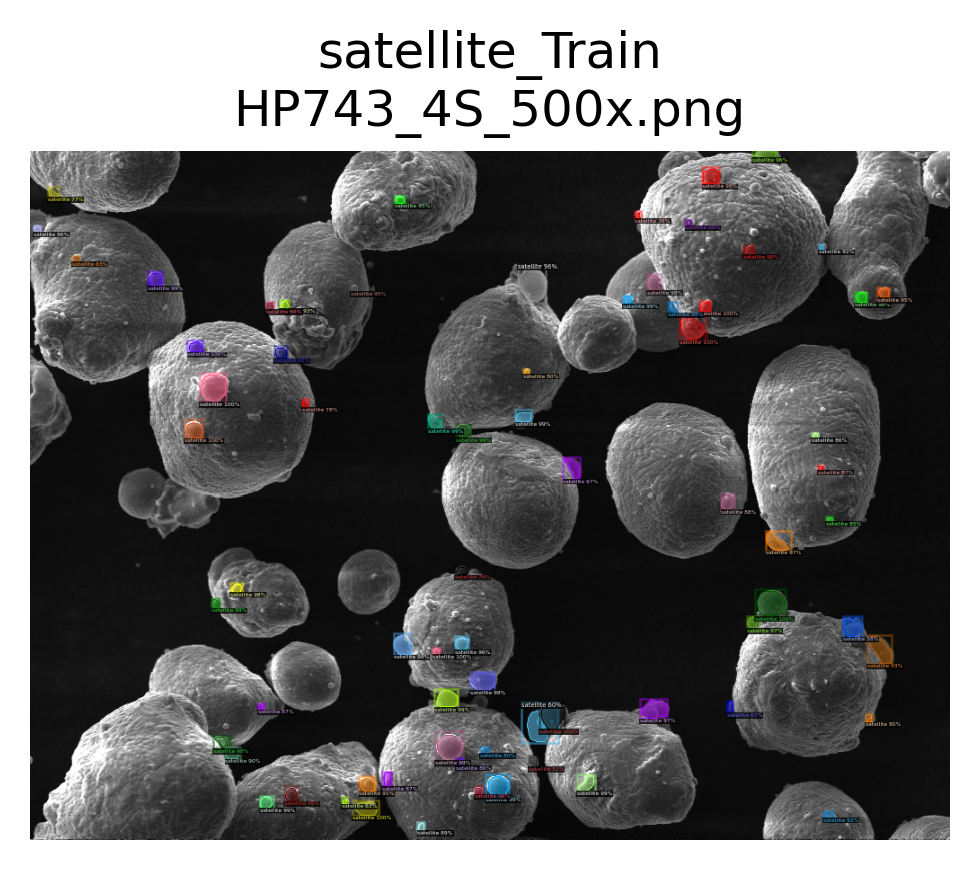

ddict info:
	path: ../data/VIA/../SEM/HP743_4S_500x.png
	num_instances: 72
	File: ../data/VIA/../SEM/HP743_2S_500x.png


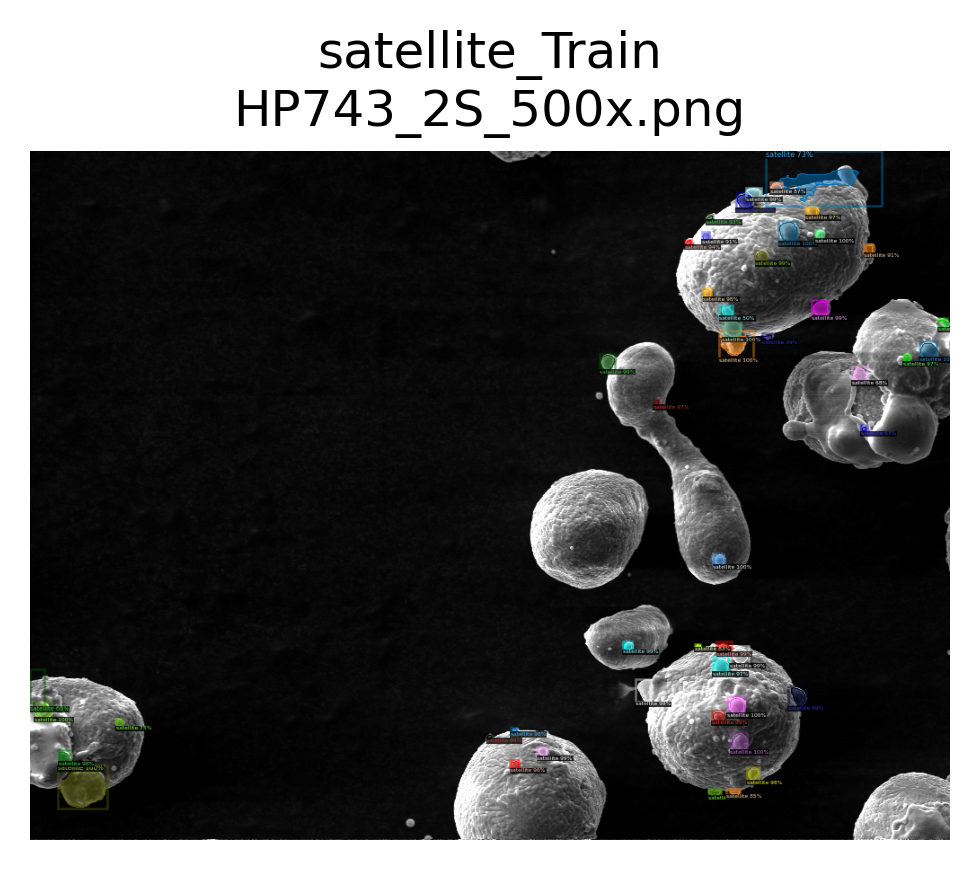

ddict info:
	path: ../data/VIA/../SEM/HP743_2S_500x.png
	num_instances: 48
	File: ../data/VIA/../SEM/HP743_11S_500x.png


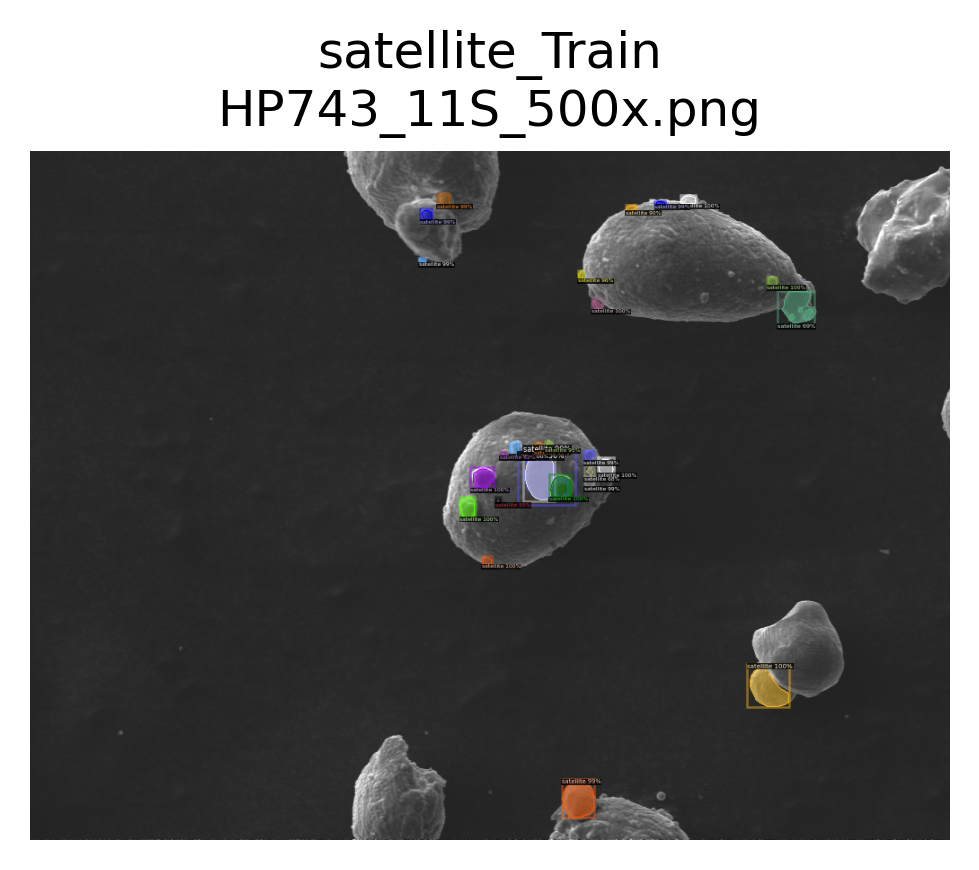

ddict info:
	path: ../data/VIA/../SEM/HP743_11S_500x.png
	num_instances: 27
	File: ../data/VIA/../SEM/HP743_10S_500x.png


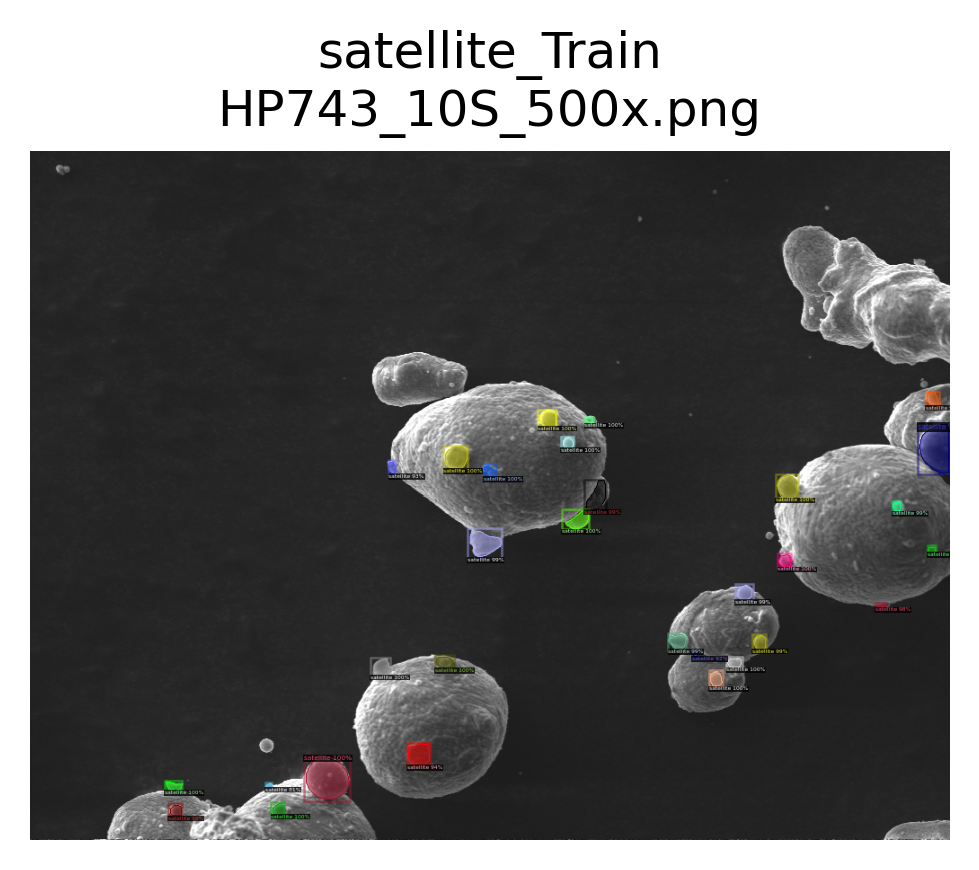

ddict info:
	path: ../data/VIA/../SEM/HP743_10S_500x.png
	num_instances: 30
	File: ../data/VIA/../SEM/HP743_12S_500x.png


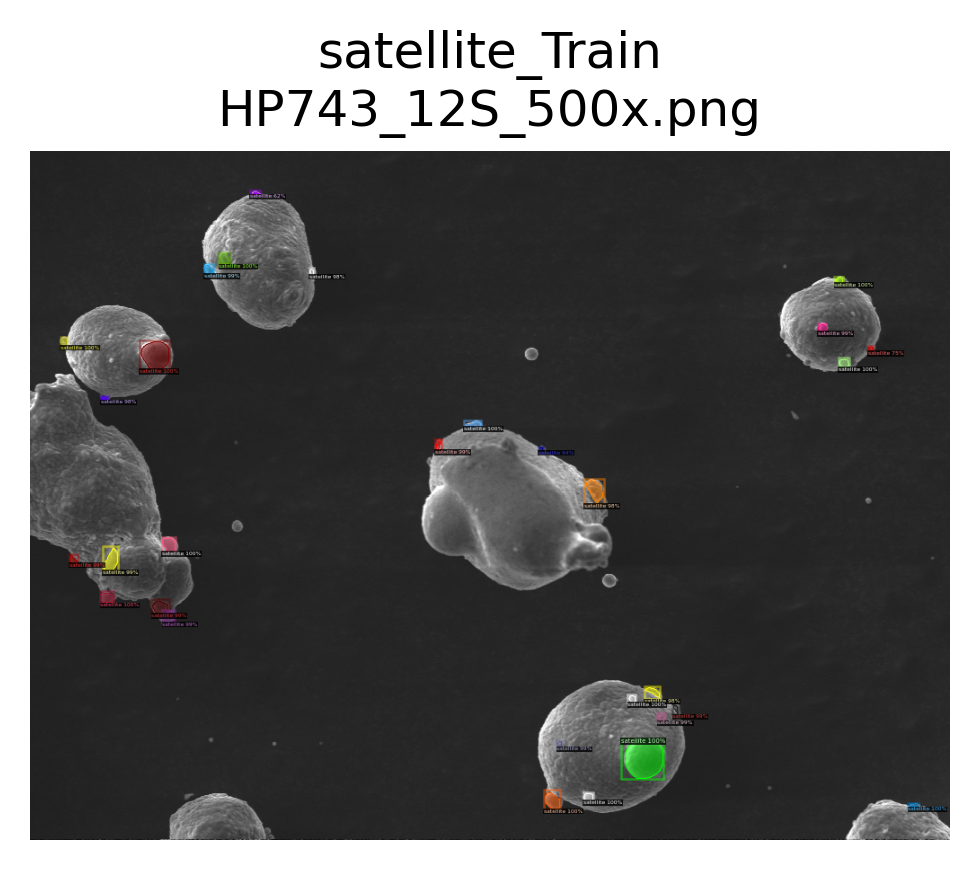

ddict info:
	path: ../data/VIA/../SEM/HP743_12S_500x.png
	num_instances: 30
	File: ../data/VIA/../SEM/HP743_3S_500x.png


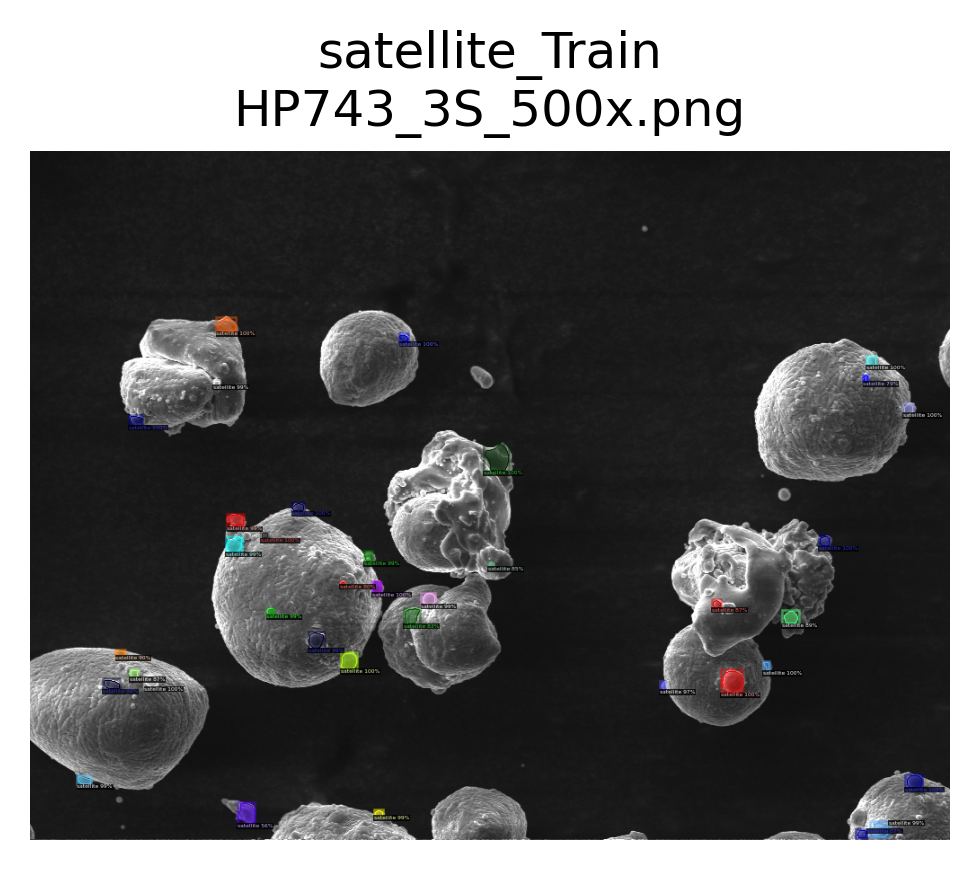

ddict info:
	path: ../data/VIA/../SEM/HP743_3S_500x.png
	num_instances: 37
	File: ../data/VIA/../SEM/HP743_1S_500x.png


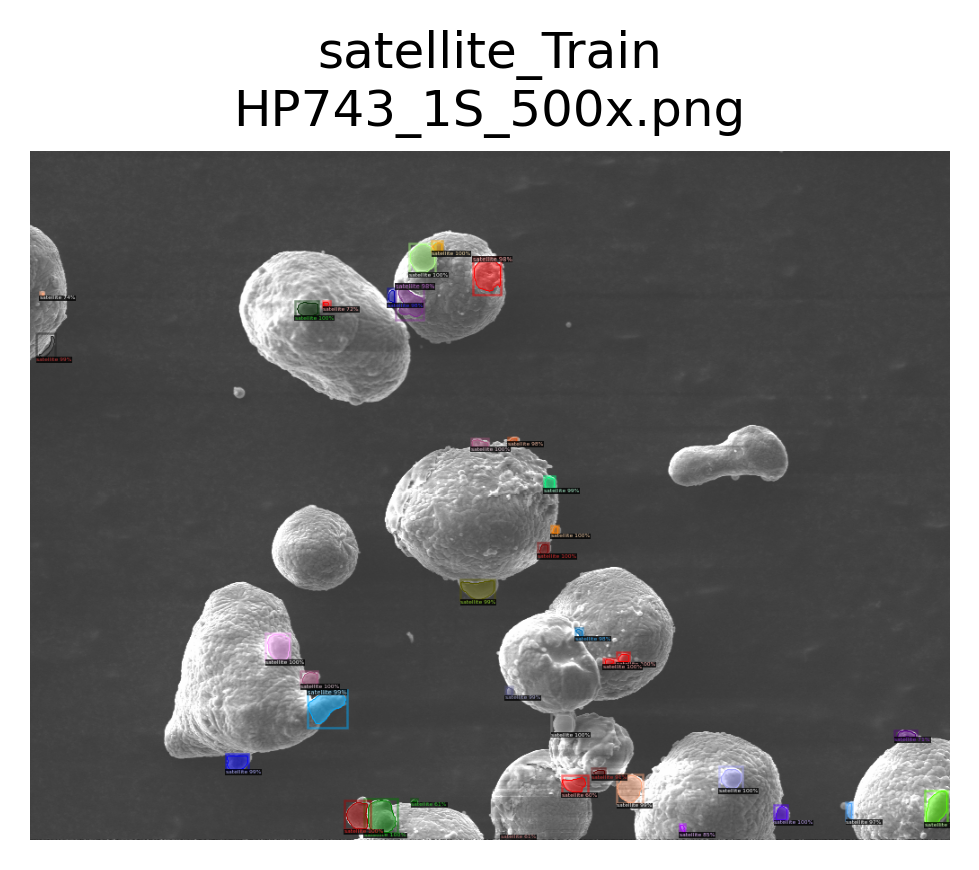

ddict info:
	path: ../data/VIA/../SEM/HP743_1S_500x.png
	num_instances: 37
	File: ../data/VIA/../SEM/HP743_5S_500x.png


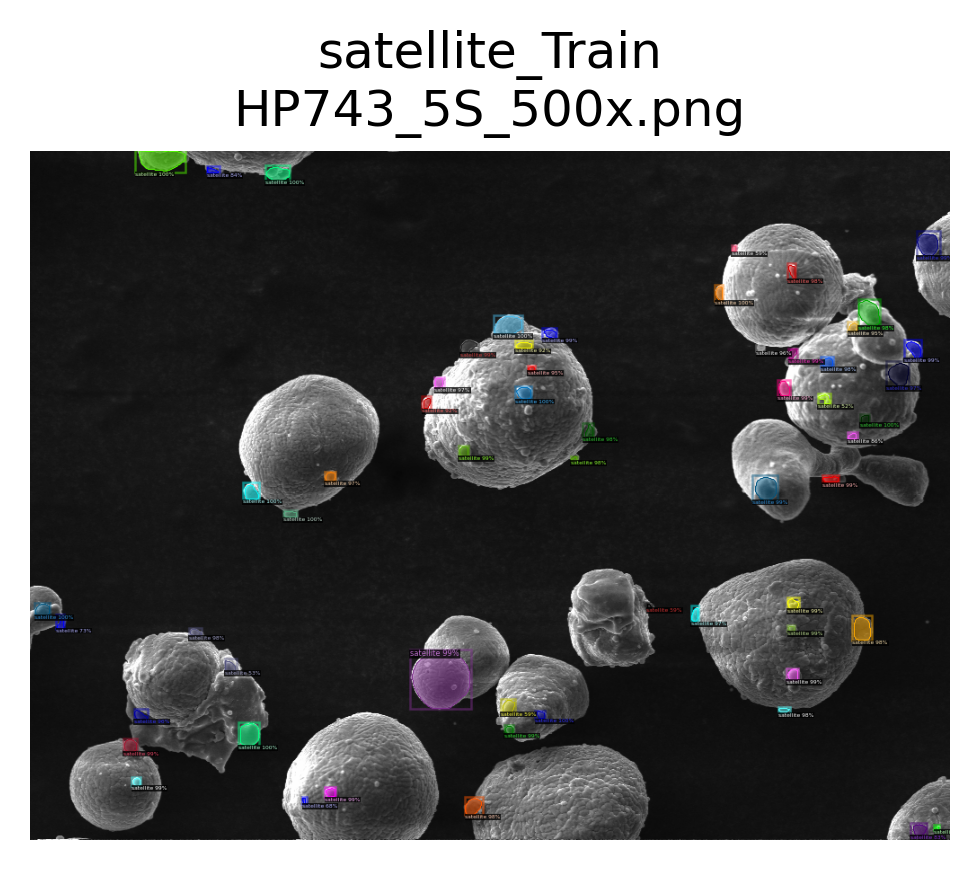

ddict info:
	path: ../data/VIA/../SEM/HP743_5S_500x.png
	num_instances: 58
	File: ../data/VIA/../SEM/S03_02_SE1_1250X35.png


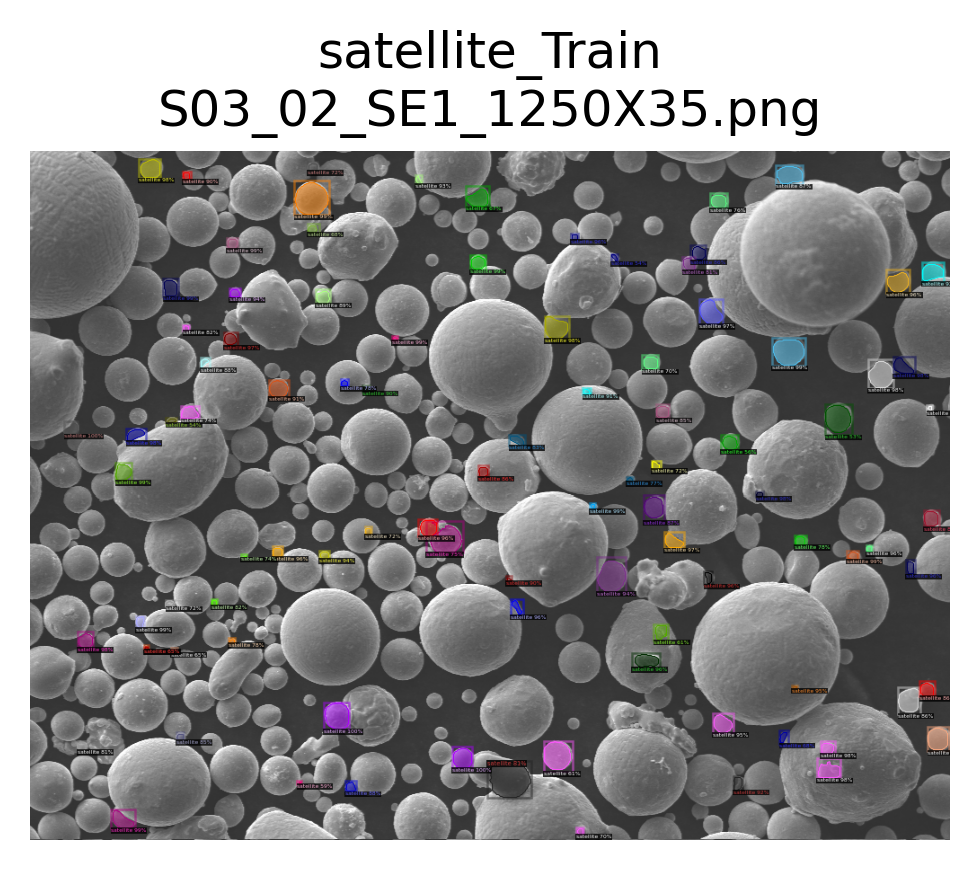

ddict info:
	path: ../data/VIA/../SEM/S03_02_SE1_1250X35.png
	num_instances: 95
	File: ../data/VIA/../SEM/S03_01_SE1_1250X28.png


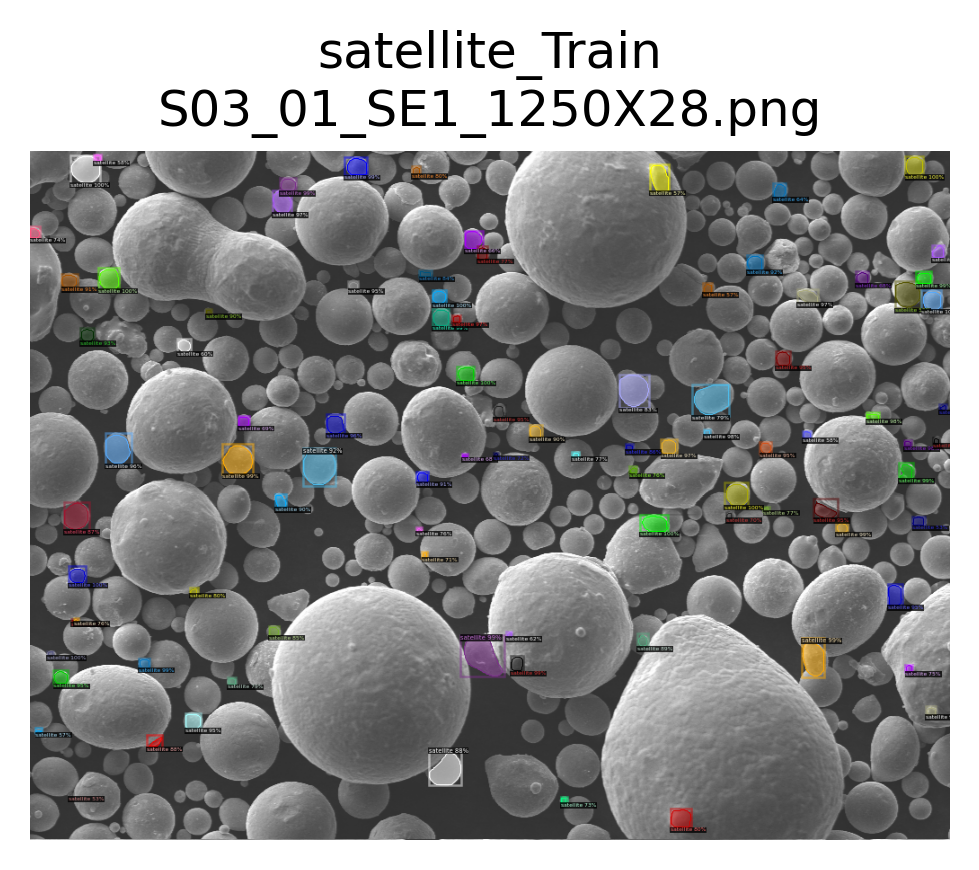

ddict info:
	path: ../data/VIA/../SEM/S03_01_SE1_1250X28.png
	num_instances: 91
	File: ../data/VIA/../SEM/S06_02_SE1_500X71.png


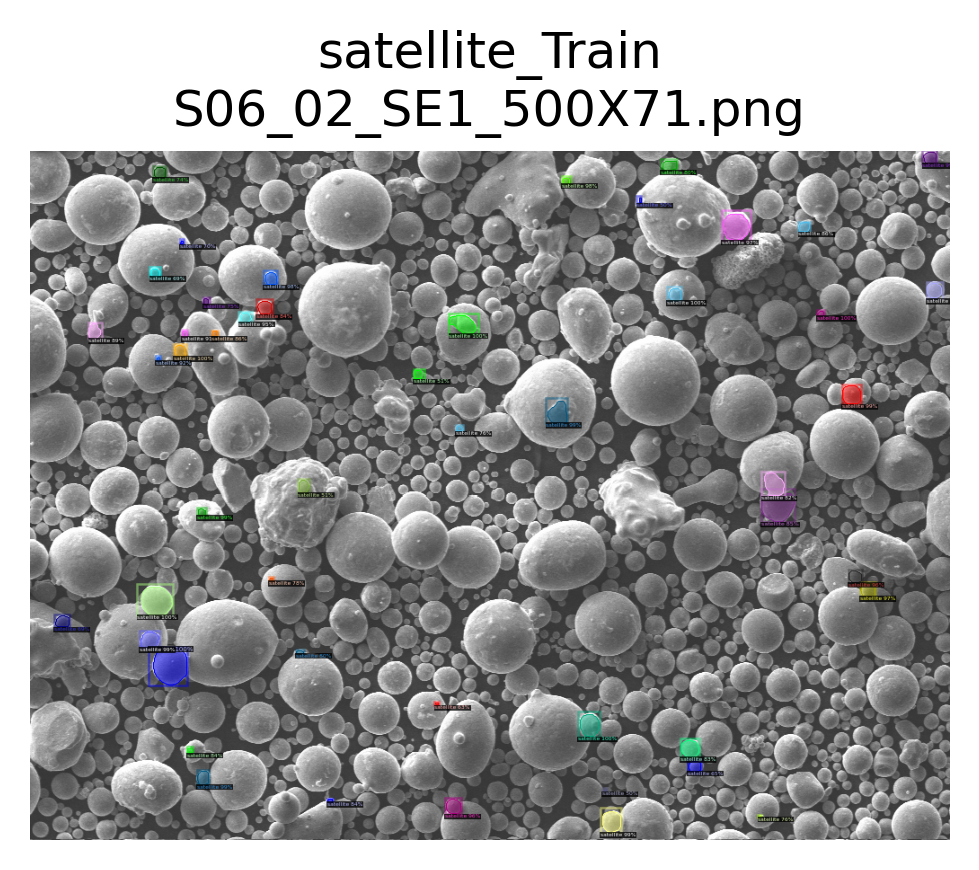

ddict info:
	path: ../data/VIA/../SEM/S06_02_SE1_500X71.png
	num_instances: 49
	File: ../data/VIA/../SEM/S06_03_SE1_500X75.png


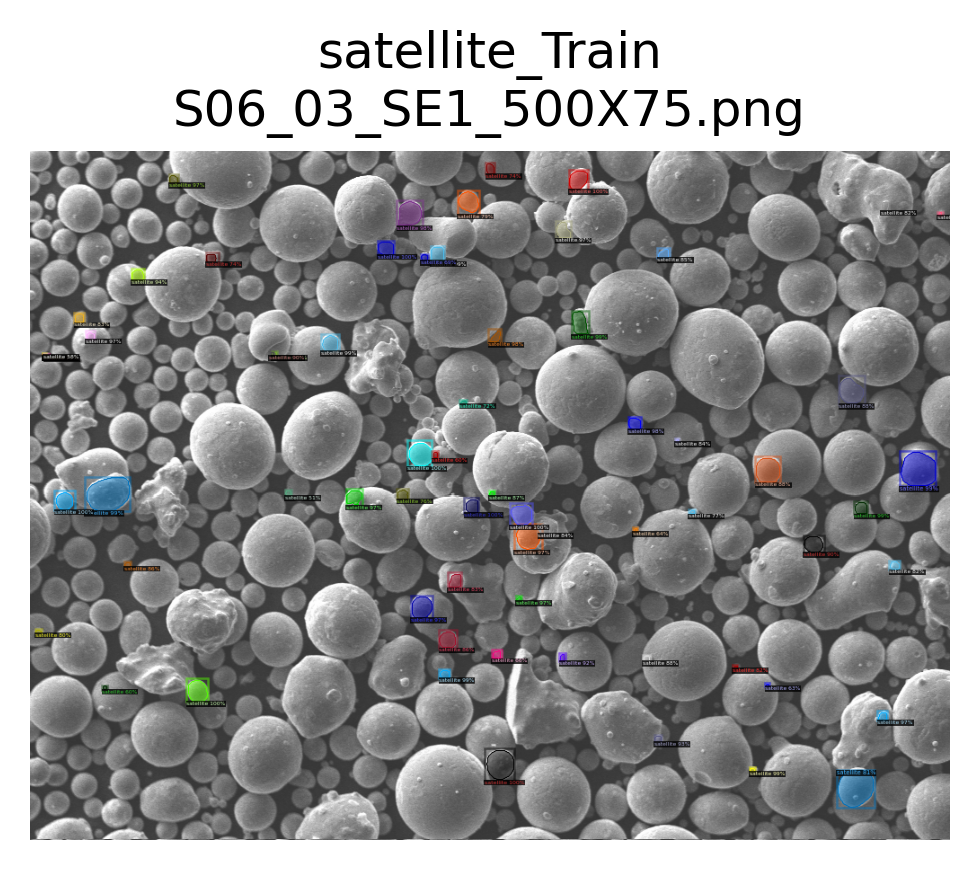

ddict info:
	path: ../data/VIA/../SEM/S06_03_SE1_500X75.png
	num_instances: 68
	File: ../data/VIA/../SEM/S02_02_SE1_300X18.png


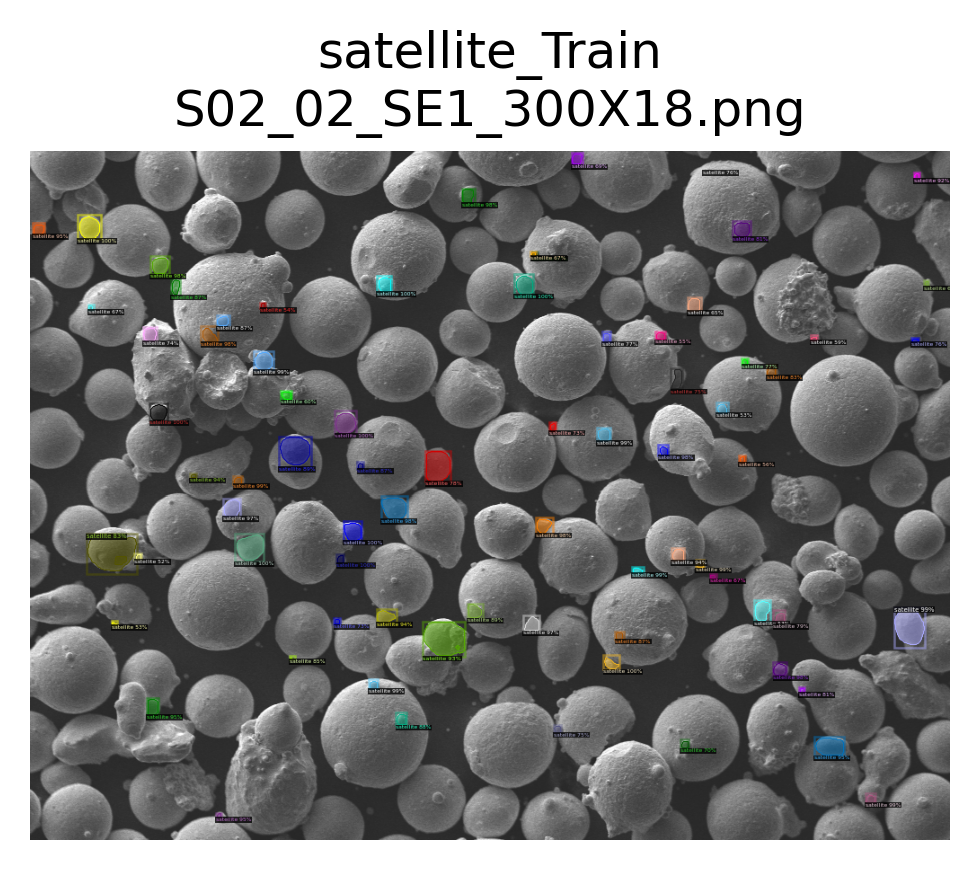

ddict info:
	path: ../data/VIA/../SEM/S02_02_SE1_300X18.png
	num_instances: 75
	File: ../data/VIA/../SEM/S02_03_SE1_300X22.png


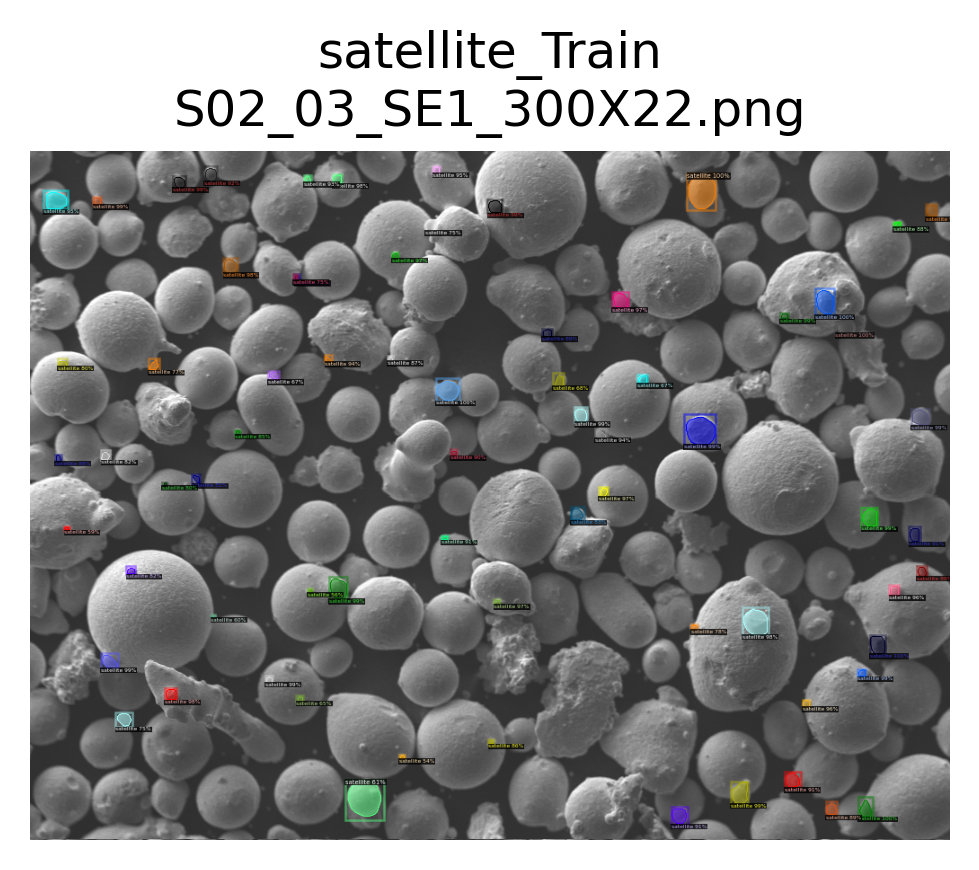

ddict info:
	path: ../data/VIA/../SEM/S02_03_SE1_300X22.png
	num_instances: 70
	File: ../data/VIA/../SEM/HP743_11S_250x.png


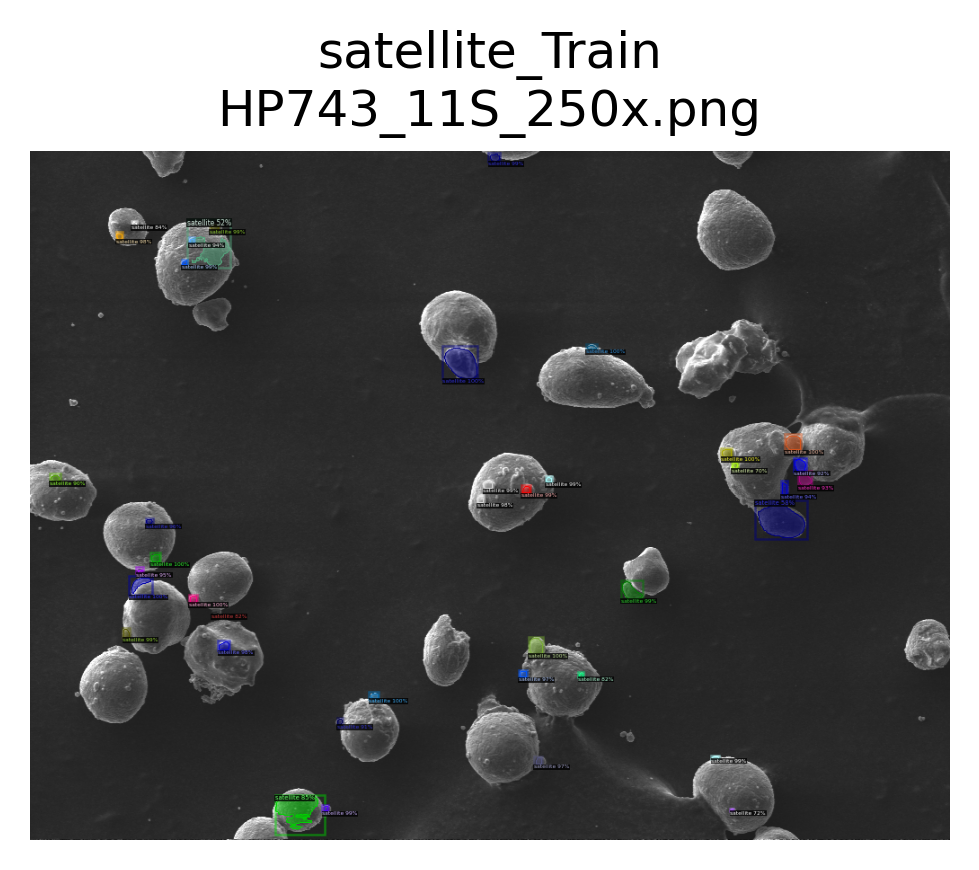

ddict info:
	path: ../data/VIA/../SEM/HP743_11S_250x.png
	num_instances: 40
	File: ../data/VIA/../SEM/HP743_6S_250x.png


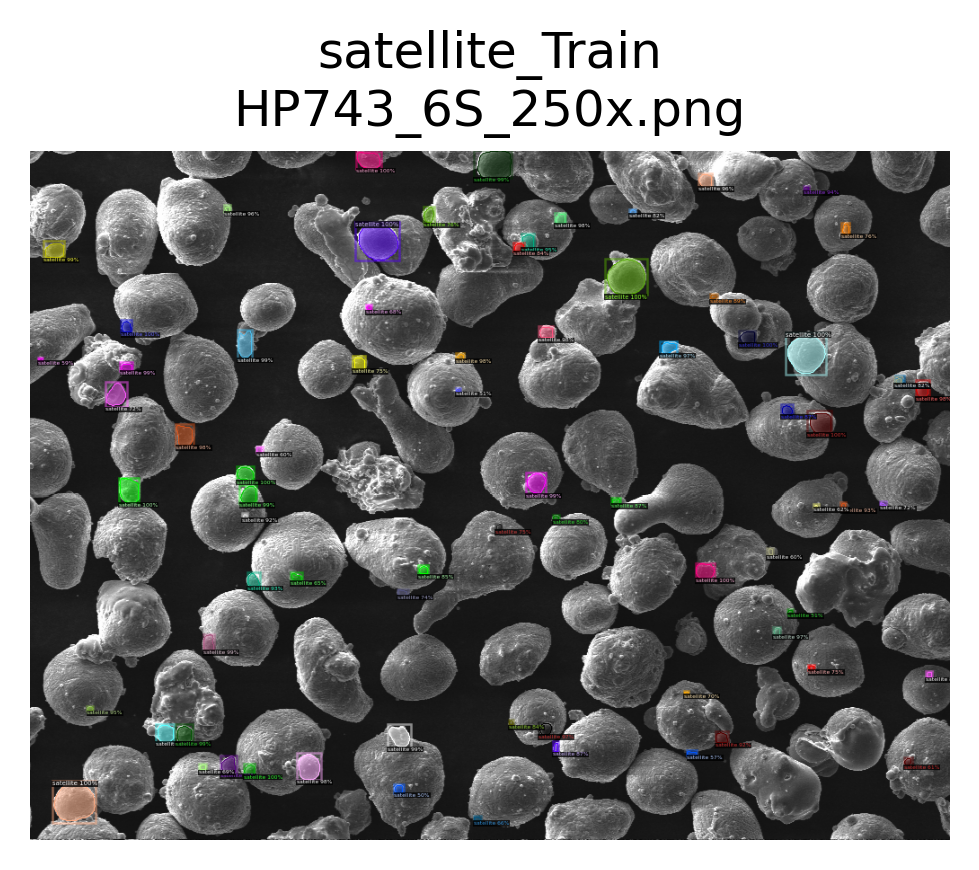

ddict info:
	path: ../data/VIA/../SEM/HP743_6S_250x.png
	num_instances: 75
	File: ../data/VIA/../SEM/S08_02_SE1_1000X99.png


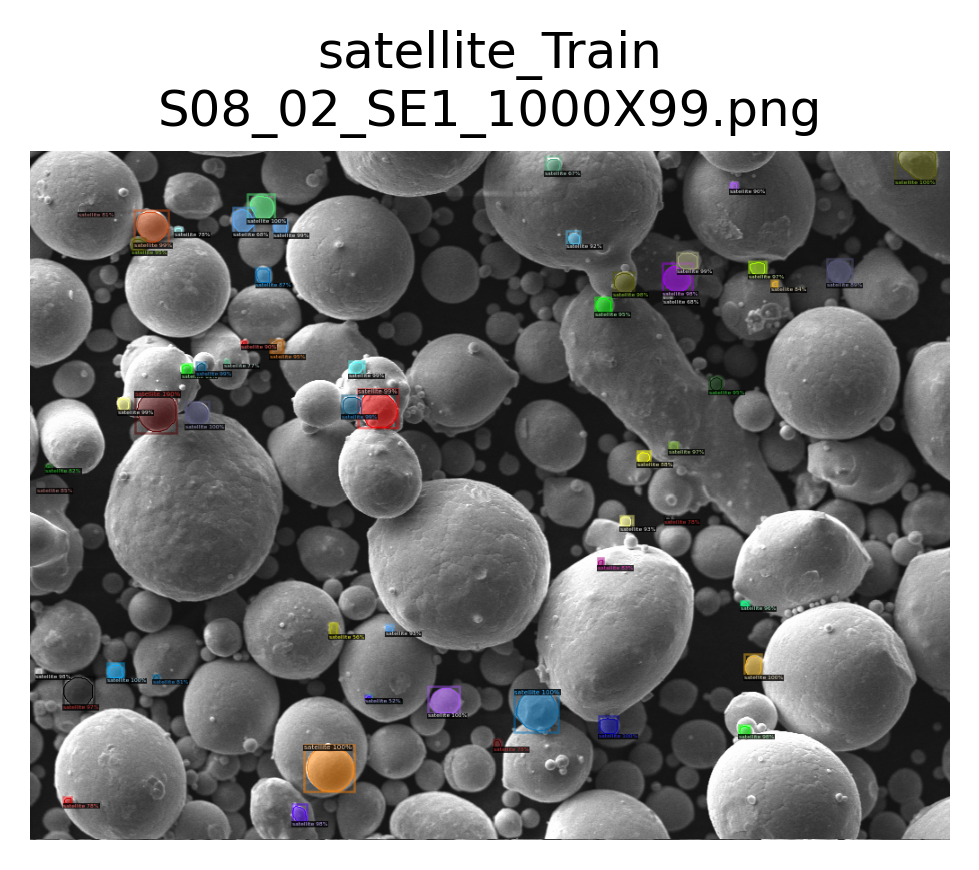

ddict info:
	path: ../data/VIA/../SEM/S08_02_SE1_1000X99.png
	num_instances: 57
	File: ../data/VIA/../SEM/S08_01_SE1_1000X94.png


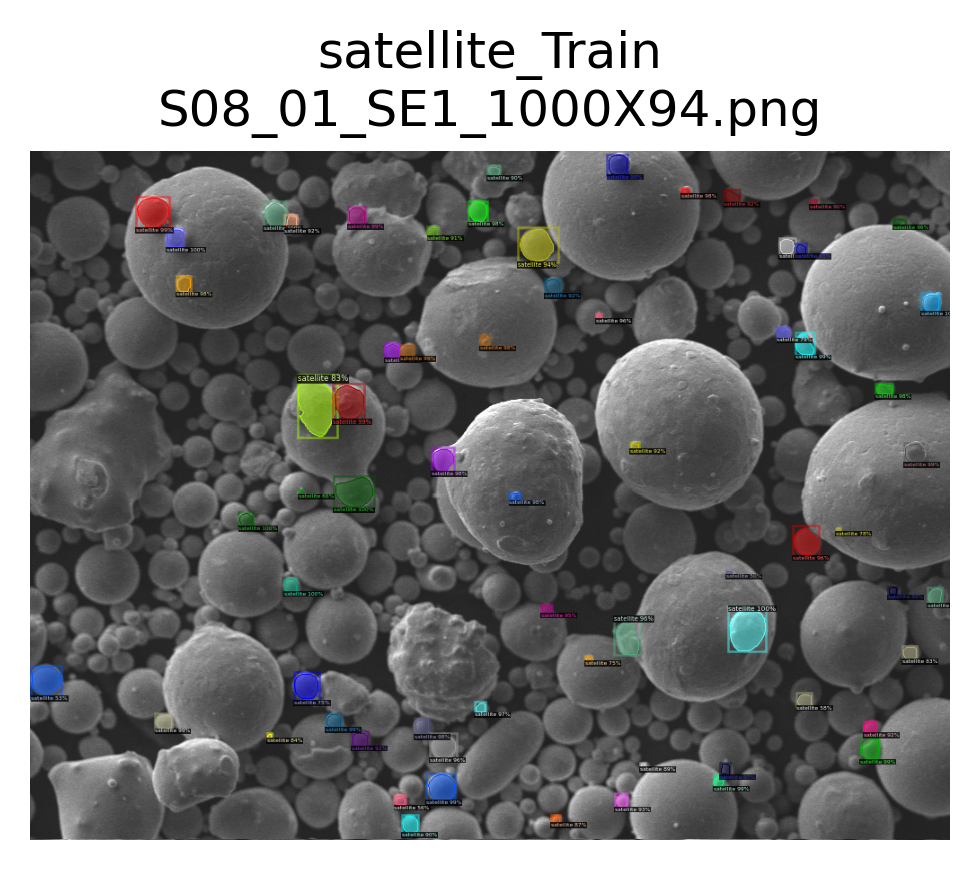

ddict info:
	path: ../data/VIA/../SEM/S08_01_SE1_1000X94.png
	num_instances: 66
	File: ../data/VIA/../SEM/S04_01_SE1_1000X45.png


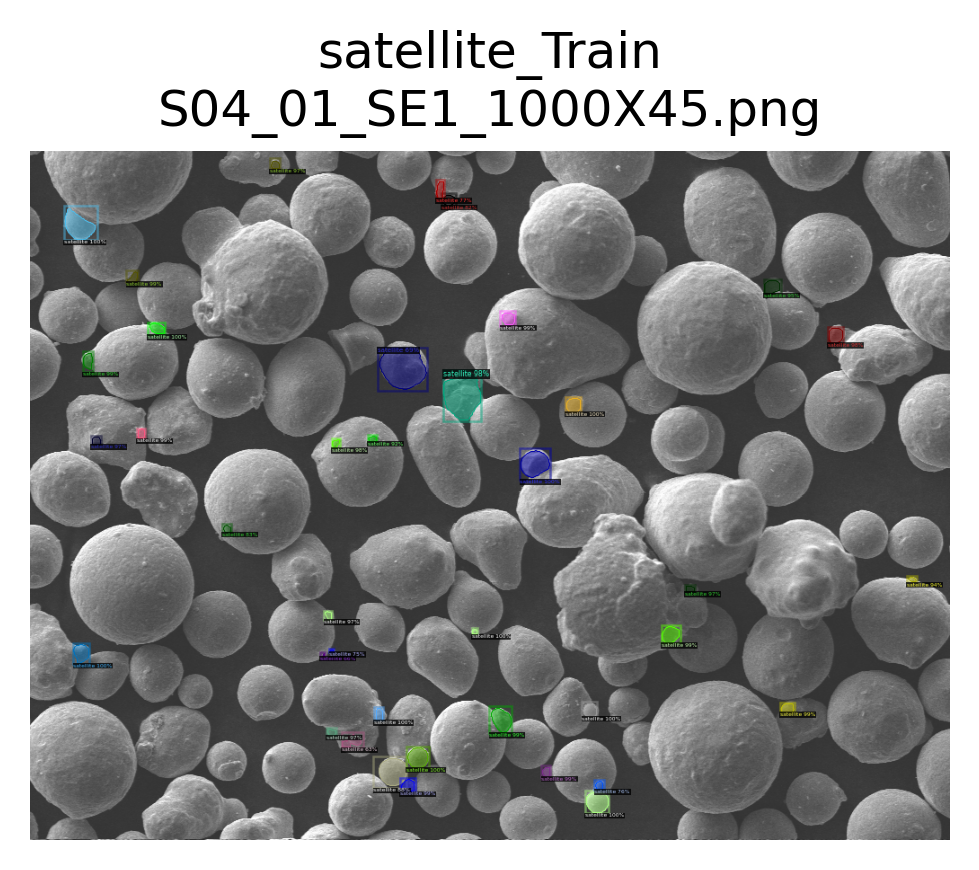

ddict info:
	path: ../data/VIA/../SEM/S04_01_SE1_1000X45.png
	num_instances: 39
	File: ../data/VIA/../SEM/S04_03_SE1_1000X53.png


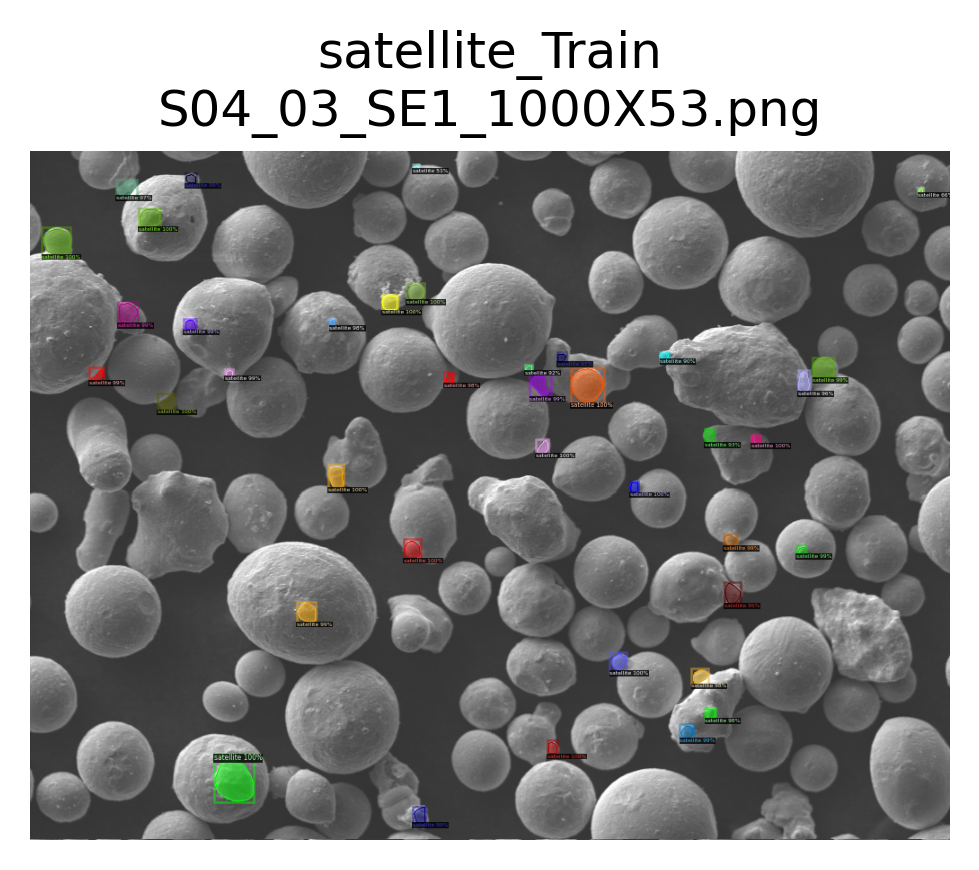

ddict info:
	path: ../data/VIA/../SEM/S04_03_SE1_1000X53.png
	num_instances: 39
Dataset: satellite_Val
	File: ../data/VIA/../SEM/S08_03_SE1_1000X03.png


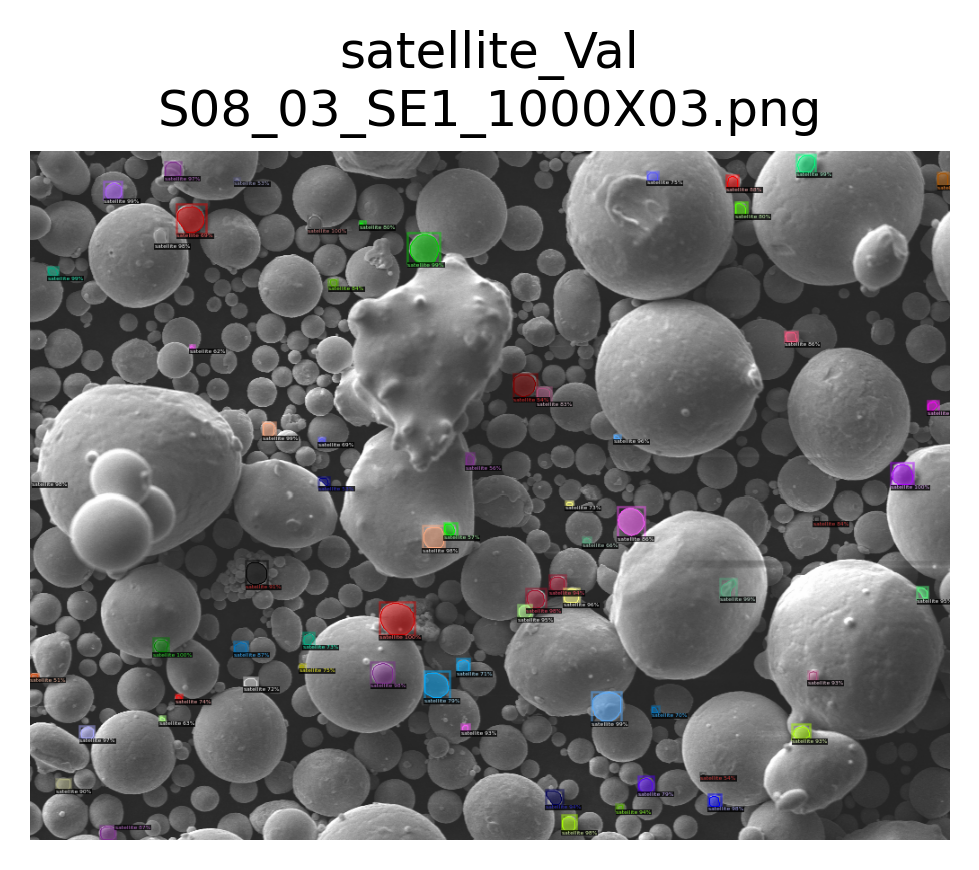

ddict info:
	path: ../data/VIA/../SEM/S08_03_SE1_1000X03.png
	num_instances: 66
	File: ../data/VIA/../SEM/S06_01_SE1_500X67.png


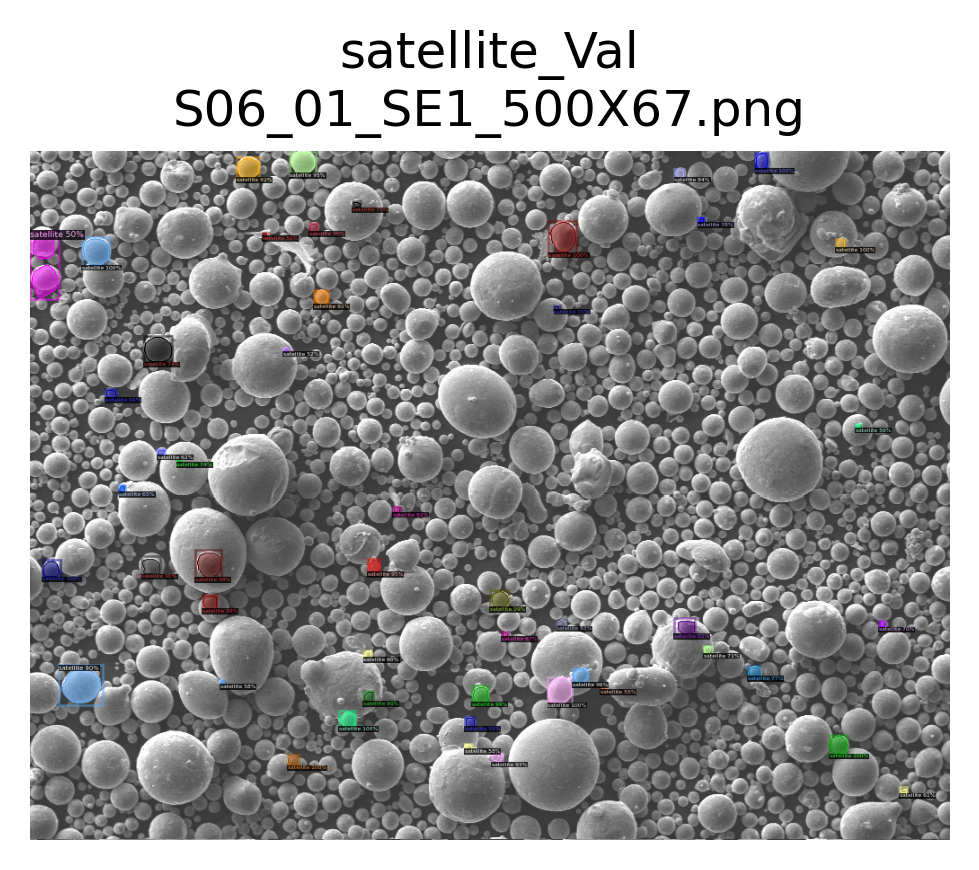

ddict info:
	path: ../data/VIA/../SEM/S06_01_SE1_500X67.png
	num_instances: 49
	File: ../data/VIA/../SEM/S04_02_SE1_1000X50.png


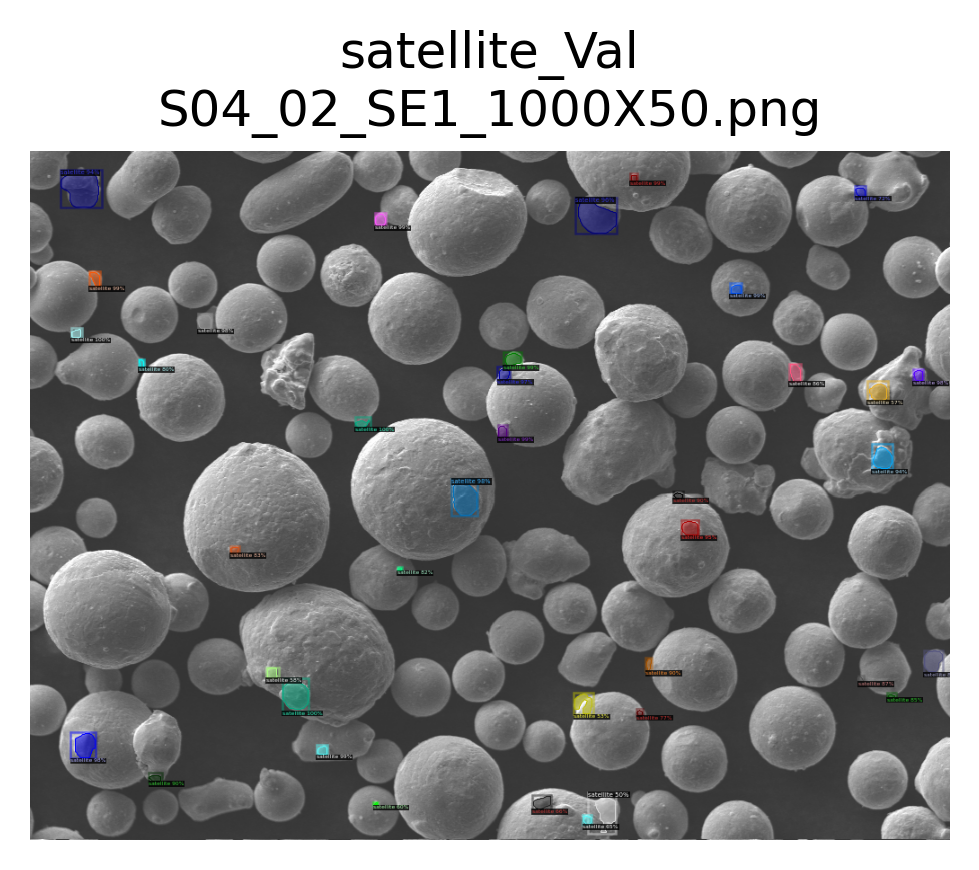

ddict info:
	path: ../data/VIA/../SEM/S04_02_SE1_1000X50.png
	num_instances: 38
	File: ../data/VIA/../SEM/S03_03_SE1_1250X41.png


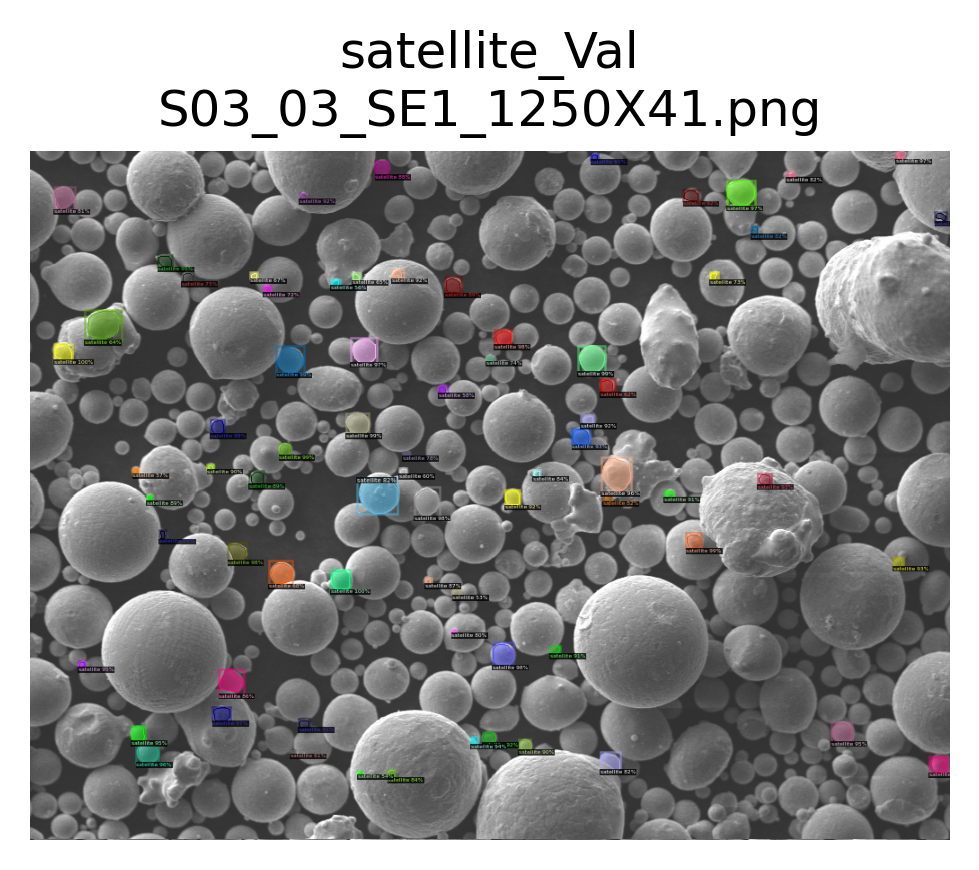

ddict info:
	path: ../data/VIA/../SEM/S03_03_SE1_1250X41.png
	num_instances: 73
	File: ../data/VIA/../SEM/S02_01_SE1_300X14.png


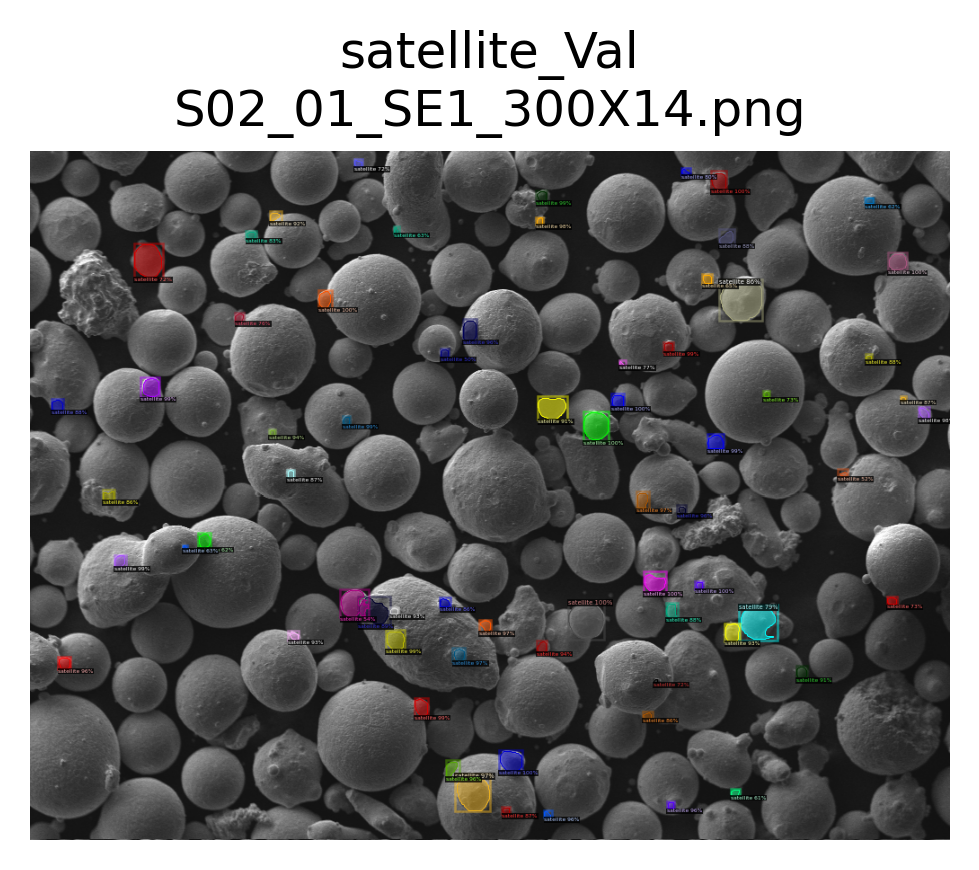

ddict info:
	path: ../data/VIA/../SEM/S02_01_SE1_300X14.png
	num_instances: 68
	File: ../data/VIA/../SEM/HP743_2S_250x.png


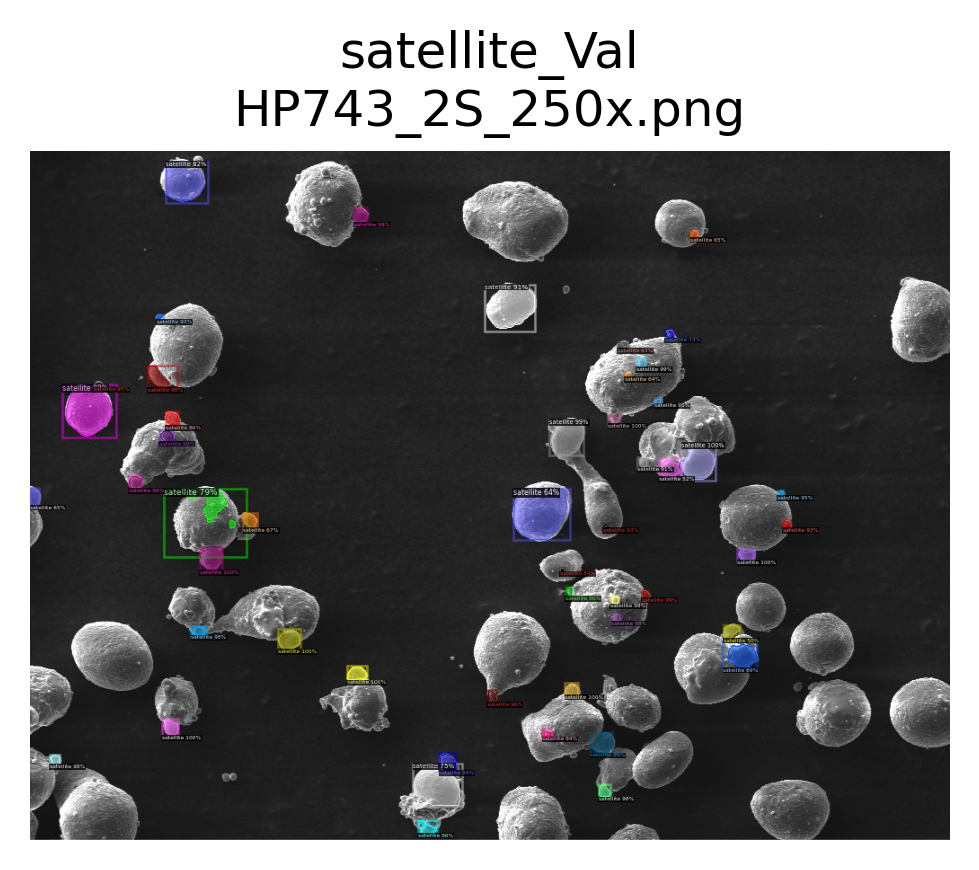

ddict info:
	path: ../data/VIA/../SEM/HP743_2S_250x.png
	num_instances: 50


In [16]:

results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
#with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
#    pickle.dump(results, f)

## Generating predictions on new images is simple.
We will load a new image (not included in either dataset) and generate predictions.
Note that we do not have labels for this image and do not need to register it to a dataset.

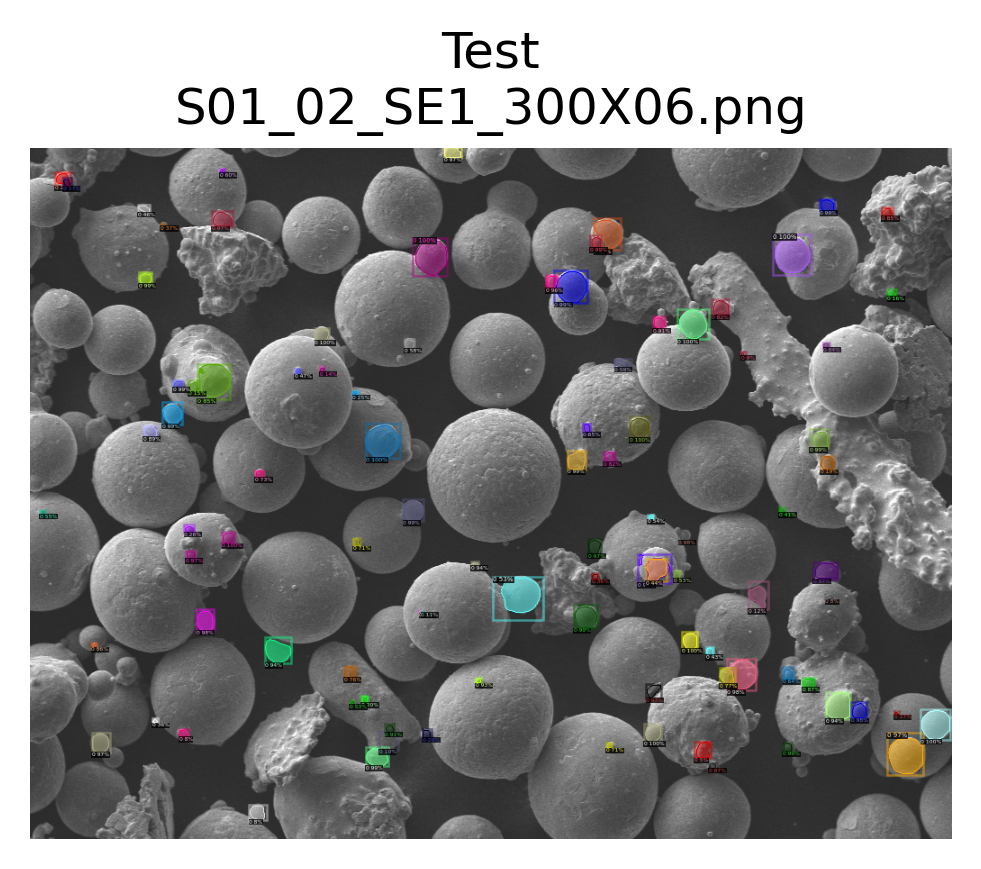

ddict info:
	path: ../data/SEM/S01_02_SE1_300X06.png
	num_instances: 95


In [11]:
img_path = Path('..', 'data','SEM', 'S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image
